2026-01-17 13:21:47,339 INFO: Loading raw data
2026-01-17 13:22:49,527 INFO: Loaded AnnData with 100064 cells and 29733 genes
2026-01-17 13:22:49,533 INFO: Running batch-aware Scrublet
2026-01-17 13:25:49,774 INFO: Removing 185 predicted doublets
2026-01-17 13:25:52,016 INFO: Calculating QC metrics and filtering
... storing 'orig.ident' as categorical
... storing 'subtype' as categorical
... storing 'celltype_subset' as categorical
... storing 'celltype_minor' as categorical
... storing 'celltype_major' as categorical


Generating QC Plots...


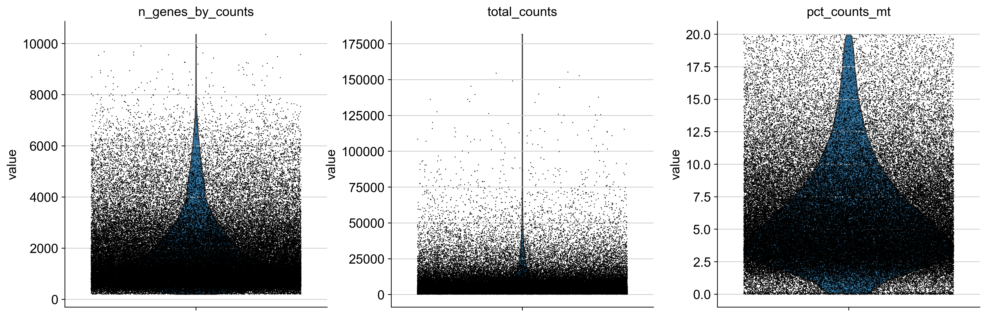

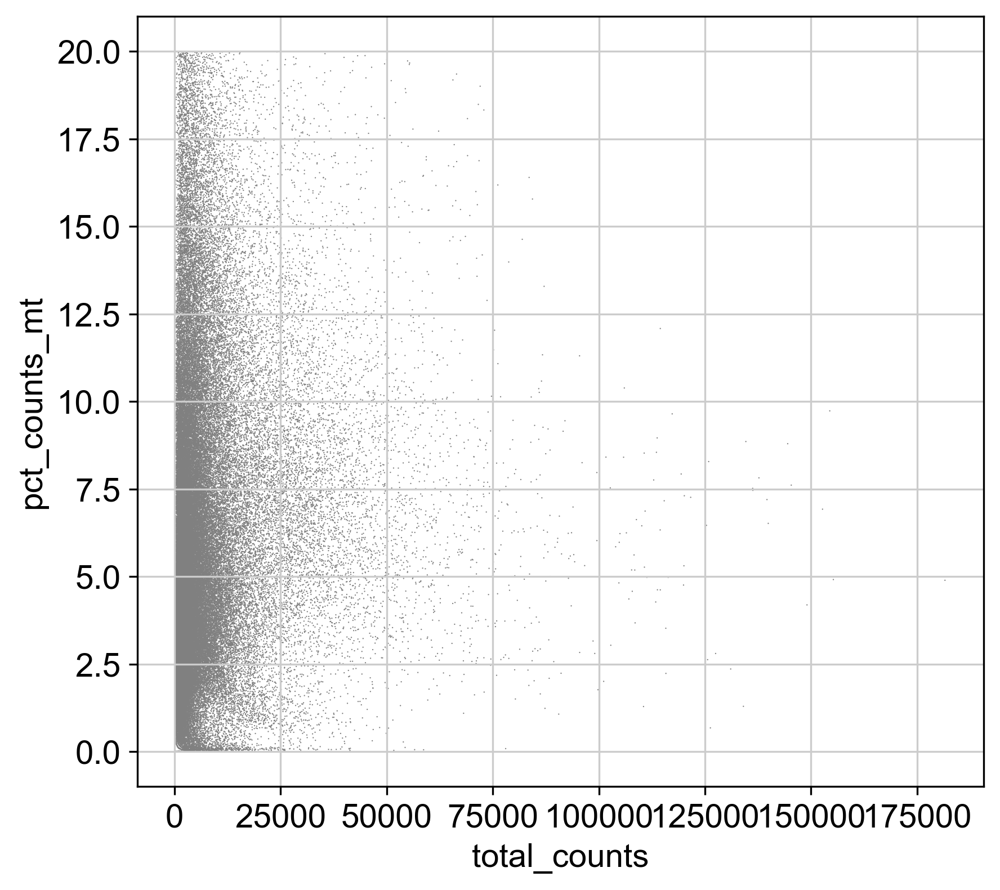

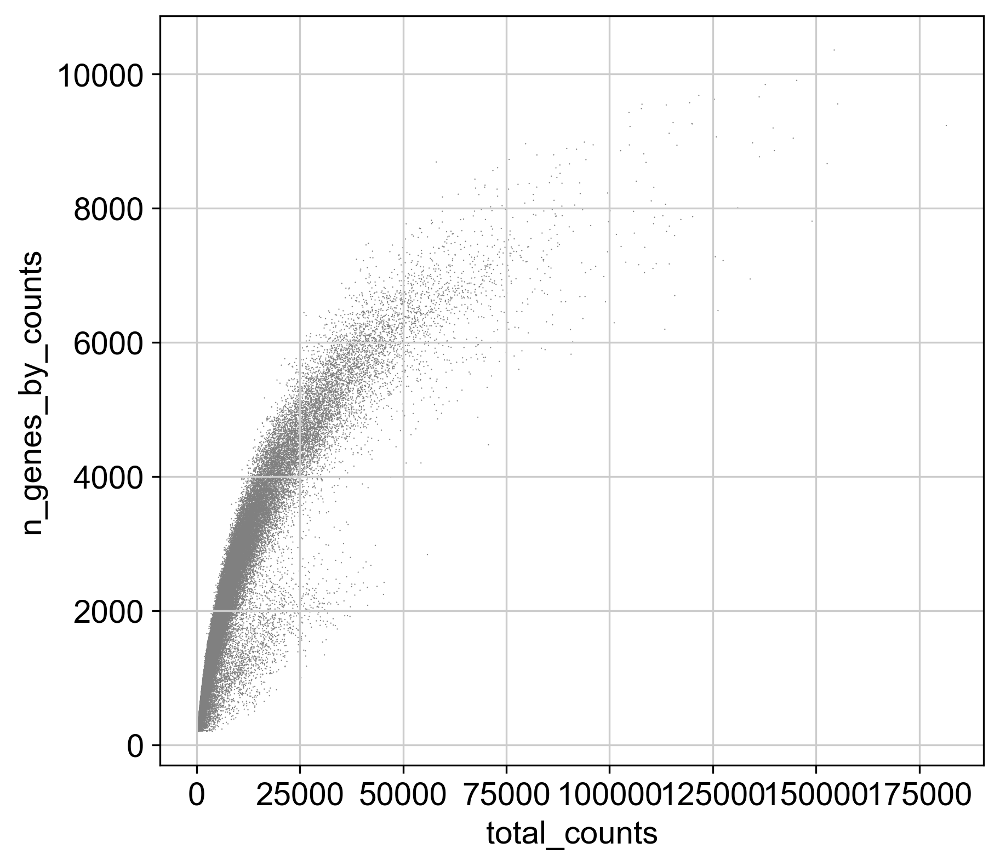

2026-01-17 13:26:09,207 INFO: After QC: 93835 cells, 27493 genes
2026-01-17 13:26:09,316 INFO: Normalizing and selecting HVGs


Generating Highly Variable Genes Plot...


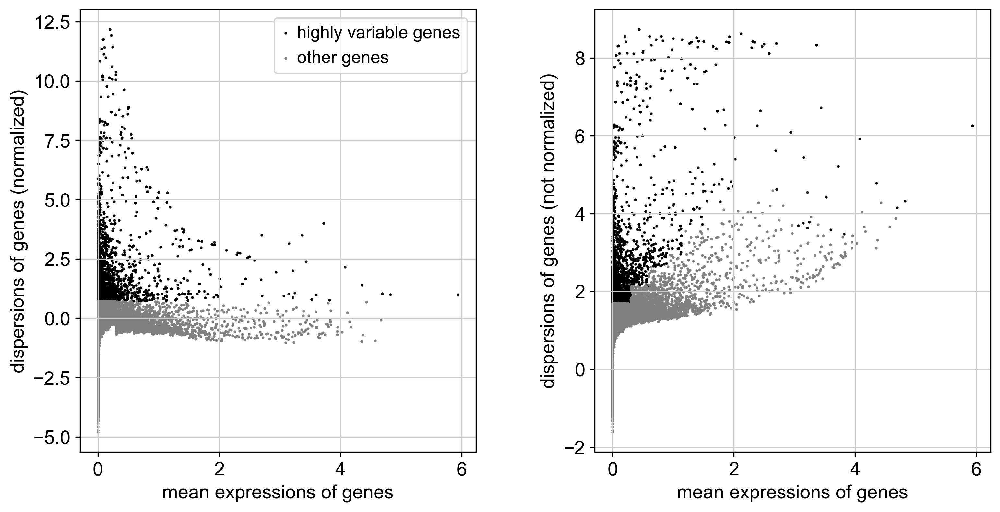

2026-01-17 13:26:14,731 INFO: Selected 3012 HVGs (including forced targets: 16)
2026-01-17 13:26:14,732 INFO: Skipping MAGIC (USE_MAGIC=False). Using log-normalized data for downstream steps.
2026-01-17 13:26:14,732 INFO: Running PCA, neighbors, Leiden, UMAP


Generating PCA Variance Plot (Elbow Plot)...


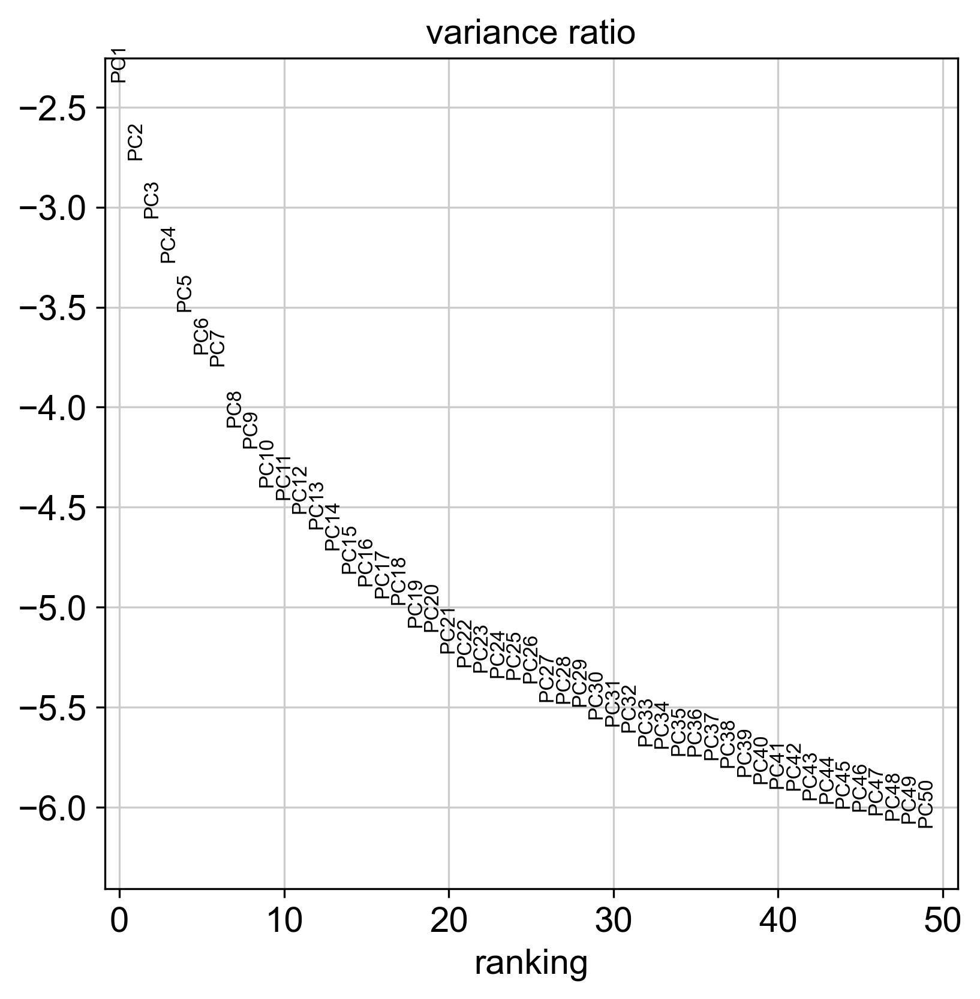

Generating PCA Scatter Plot...


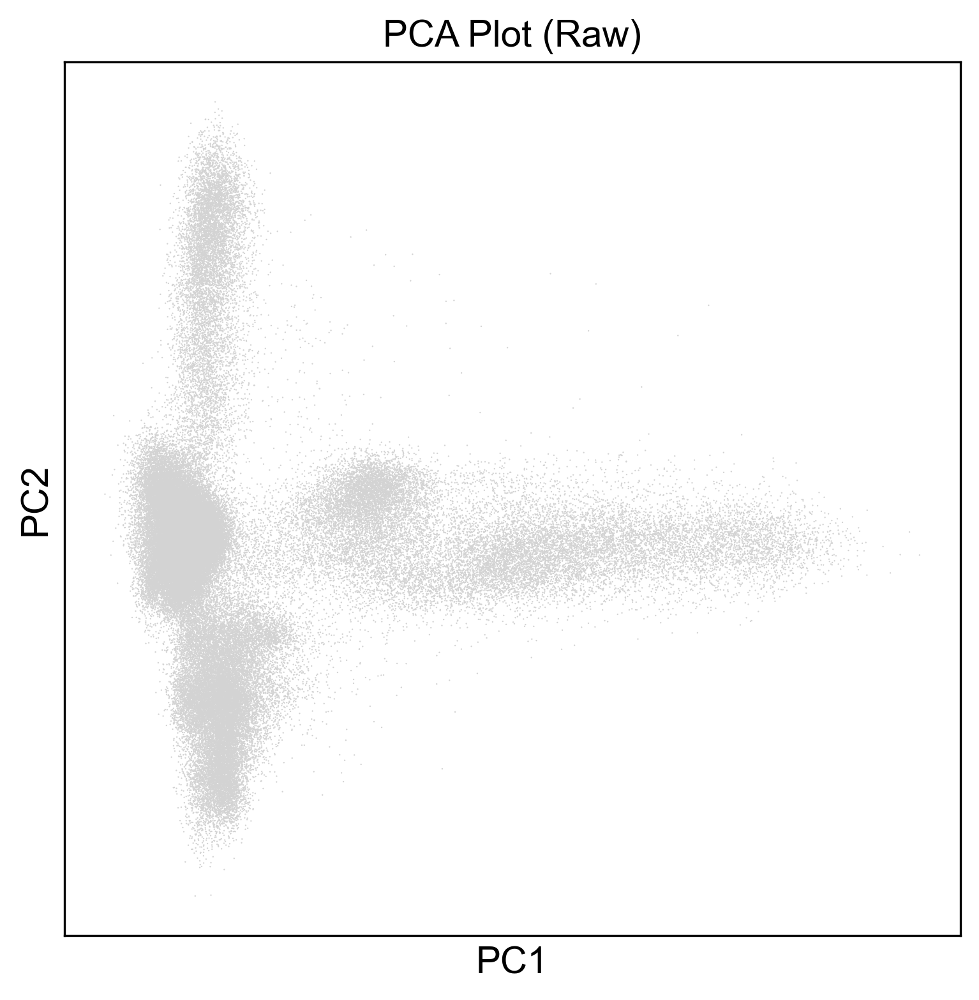

Generating PCA Plot colored by Clusters...


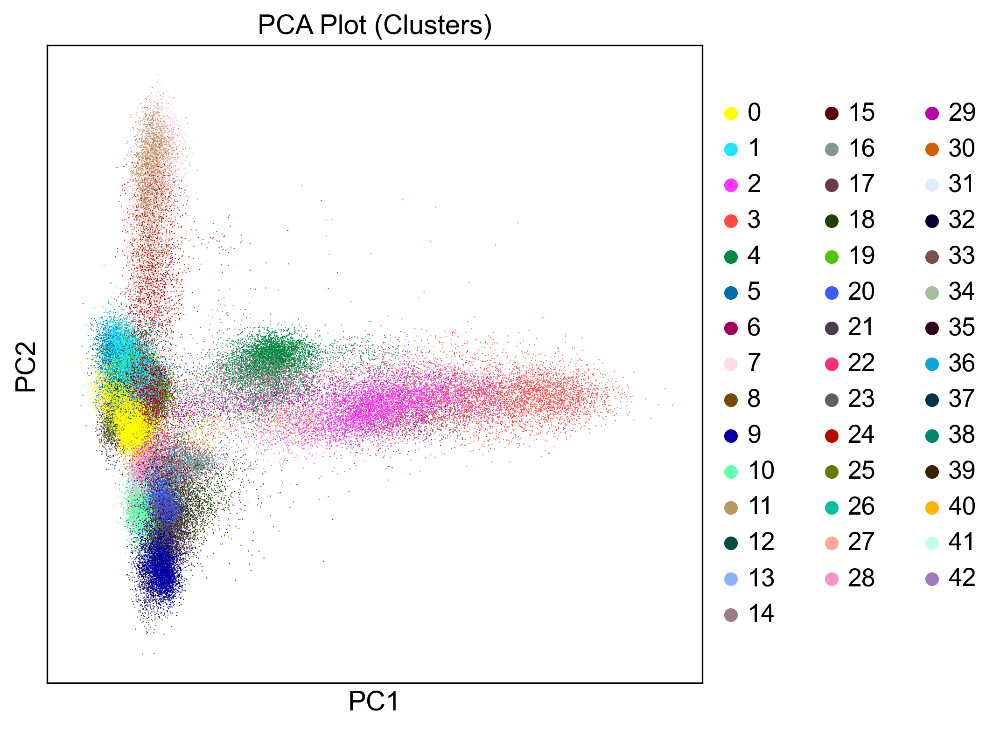

2026-01-17 13:29:42,415 INFO: Scoring marker sets and saving plots


2026-01-17 13:29:47,337 INFO: Saved metadata to /Users/prabhasavvaru/Downloads/Wu_etal_2021_BRCA_scRNASeq_outputs_3/GSE176078_metadata_v2.csv


2026-01-17 13:29:51,528 INFO: Creating pseudobulk (patient x cluster) from malignant-like cells
2026-01-17 13:29:54,194 INFO: Pseudobulk will use 16582 malignant-like cells
2026-01-17 13:30:18,140 INFO: Saved pseudobulk to /Users/prabhasavvaru/Downloads/Wu_etal_2021_BRCA_scRNASeq_outputs_3/pseudobulk_patient_cluster_logCPM.csv
2026-01-17 13:30:18,147 INFO: Saving final AnnData and cluster CSV
2026-01-17 13:30:18,760 INFO: Saved clusters CSV to /Users/prabhasavvaru/Downloads/Wu_etal_2021_BRCA_scRNASeq_outputs_3/clustering_results.csv
2026-01-17 13:30:18,761 INFO: Pipeline completed successfully


In [2]:
#!/usr/bin/env python3
"""
Refactored scRNA-seq pipeline tuned for downstream drug-sensitivity analysis.
Features:
 - modular phases (load, scrublet, QC, normalization/HVG, optional MAGIC, clustering)
 - safer memory handling (avoid densifying huge matrices)
 - pseudobulk creation (patient x cluster) for oncoPredict / bulk drug models
 - pathway/target scoring for drug mechanism inference
 - config export and robust logging
"""

import os
import sys
import json
import gc
import logging
import warnings
from pathlib import Path
from typing import List, Dict

import numpy as np
import pandas as pd
import scanpy as sc
import scrublet as scr
import magic
import matplotlib.pyplot as plt

# -------------------------
# Configuration (edit as needed)
# -------------------------
warnings.filterwarnings("ignore")
logging.basicConfig(level=logging.INFO, format="%(asctime)s %(levelname)s: %(message)s")
RNG_SEED = 42
np.random.seed(RNG_SEED)
sc.settings.set_figure_params(dpi=150, figsize=(6, 6))

BASE_PATH = Path.home() / "Downloads" / "Wu_etal_2021_BRCA_scRNASeq"
OUTPUT_PATH = Path.home() / "Downloads" / "Wu_etal_2021_BRCA_scRNASeq_outputs_3"
OUTPUT_PATH.mkdir(parents=True, exist_ok=True)

# Input files
MTX_PATH = BASE_PATH / "count_matrix_sparse.mtx"
GENES_PATH = BASE_PATH / "count_matrix_genes.tsv"
BARCODES_PATH = BASE_PATH / "count_matrix_barcodes.tsv"
META_PATH = BASE_PATH / "metadata.csv"

# Outputs
OUT_MAGIC_MATRIX = OUTPUT_PATH / "GSE176078_MAGIC_imputed_genes_x_cells_v2.csv"
OUT_METADATA = OUTPUT_PATH / "GSE176078_metadata_v2.csv"
OUT_FINAL_OBJ = OUTPUT_PATH / "annotated_brca_object.h5ad"
OUT_CLUSTERS_CSV = OUTPUT_PATH / "clustering_results.csv"
OUT_PSEUDOBULK = OUTPUT_PATH / "pseudobulk_patient_cluster_logCPM.csv"
OUT_CONFIG = OUTPUT_PATH / "pipeline_config.json"

# Parameters
CONFIG = {
    "MIN_COUNTS": 500,
    "PERCENTILE": 99.5,
    "MAX_MITO_PERCENT": 15.0,
    "HVG_N": 3000,
    "SCRUBLET_RATE": 0.06,
    "SCRUBLET_MIN_CELLS": 50,
    "LEIDEN_RES": 0.8,
    "N_PCS": 50,
    "N_NEIGHBORS": 15,
    "USE_MAGIC": False,            # Set True to run MAGIC (caution: can oversmooth)
    "MAGIC_N_JOBS": -1,
    "DENSE_THRESHOLD": 200e6      # if n_cells * n_genes < threshold, densify is allowed
}

# Drug targets and markers (kept from your original)
DRUG_TARGETS = [
    "ESR1","PGR","ERBB2","MKI67","EGFR","PIK3CA","AKT1","TP53",
    "BRCA1","BRCA2","TOP2A","CDK4","CDK6","BCL2","PTEN","ATM"
]

MARKERS = {
    "Cancer Epithelial": ["ERBB2", "FOXA1", "MUC1", "GRB7"],
    "T cells":           ["GZMA", "CD8A", "GZMK", "NKG7"],
    "B cells":           ["MS4A1", "CD79A", "CD19"],
    "Myeloid":           ["LYZ", "CD68", "FCGR3A"],
    "CAFs":              ["COL1A1", "DCN", "LUM"],
    "Endothelial":       ["PECAM1", "VWF", "CLDN5"],
    "PVLs":              ["RGS5", "MCAM", "ACTA2"],
    "Plasmablasts":      ["JCHAIN", "MZB1", "IGHG1"]
}

# Save config for reproducibility
with open(OUT_CONFIG, "w") as fh:
    json.dump({"RNG_SEED": RNG_SEED, **CONFIG}, fh, indent=2)

# -------------------------
# Helper utilities
# -------------------------
def ensure_mtx_header(file_path: Path) -> Path:
    if not file_path.exists():
        raise FileNotFoundError(f"Missing: {file_path}")
    with file_path.open("r") as f:
        first = f.readline()
    if first.startswith("%%MatrixMarket"):
        return file_path
    fixed = file_path.with_name(file_path.stem + "_fixed.mtx")
    logging.info(f"Adding MatrixMarket header to {file_path} -> {fixed}")
    with fixed.open("w") as fout:
        fout.write("%%MatrixMarket matrix coordinate integer general\n")
        with file_path.open("r") as fin:
            for line in fin:
                fout.write(line)
    return fixed

def safe_toarray(X, dense_threshold=CONFIG["DENSE_THRESHOLD"]):
    """Convert sparse to dense only if product size is below threshold."""
    try:
        n_cells, n_genes = X.shape
    except Exception:
        return X
    if n_cells * n_genes <= dense_threshold:
        return X.A if hasattr(X, "A") else np.asarray(X)
    else:
        return X  # keep sparse

# -------------------------
# Pipeline phases
# -------------------------
def load_data(mtx_path: Path, genes_path: Path, barcodes_path: Path, meta_path: Path) -> sc.AnnData:
    logging.info("Loading raw data")
    clean_mtx = ensure_mtx_header(mtx_path)
    adata = sc.read_mtx(str(clean_mtx)).T  # cells x genes
    genes = pd.read_csv(genes_path, header=None, sep="\t")
    barcodes = pd.read_csv(barcodes_path, header=None, sep="\t")
    adata.var_names = genes[0].astype(str).values
    adata.obs_names = barcodes[0].astype(str).values
    adata.var_names_make_unique()
    # metadata
    meta = pd.read_csv(meta_path, index_col=0)
    common_idx = meta.index.intersection(adata.obs_names)
    adata = adata[common_idx, :].copy()
    adata.obs = meta.loc[adata.obs_names].copy()
    logging.info(f"Loaded AnnData with {adata.n_obs} cells and {adata.n_vars} genes")
    return adata

def run_scrublet_batchwise(adata: sc.AnnData, batch_key: str = "orig.ident") -> sc.AnnData:
    logging.info("Running batch-aware Scrublet")
    d_preds = pd.Series(False, index=adata.obs_names, dtype=bool)
    if batch_key in adata.obs.columns:
        for batch in adata.obs[batch_key].unique():
            mask = adata.obs[batch_key] == batch
            batch_data = adata[mask].copy()
            if batch_data.n_obs < CONFIG["SCRUBLET_MIN_CELLS"]:
                logging.info(f"Skipping Scrublet for batch {batch} (n={batch_data.n_obs})")
                continue
            try:
                X_for_scrub = safe_toarray(batch_data.X)
                scrub = scr.Scrublet(X_for_scrub, expected_doublet_rate=CONFIG["SCRUBLET_RATE"])
                _, preds = scrub.scrub_doublets(verbose=False)
                d_preds.loc[batch_data.obs_names] = preds.astype(bool)
            except Exception as e:
                logging.warning(f"Scrublet failed for batch {batch}: {e}")
                continue
    else:
        try:
            X_for_scrub = safe_toarray(adata.X)
            scrub = scr.Scrublet(X_for_scrub, expected_doublet_rate=CONFIG["SCRUBLET_RATE"])
            _, preds = scrub.scrub_doublets(verbose=False)
            d_preds[:] = preds.astype(bool)
        except Exception as e:
            logging.warning(f"Global Scrublet failed: {e}")
    removed = int(d_preds.sum())
    if removed > 0:
        logging.info(f"Removing {removed} predicted doublets")
        adata = adata[~d_preds, :].copy()
    else:
        logging.info("No doublets removed")
    gc.collect()
    return adata

def qc_and_filter(adata: sc.AnnData) -> sc.AnnData:
    logging.info("Calculating QC metrics and filtering")
    adata.var["mt"] = adata.var_names.str.upper().str.startswith("MT-")
    sc.pp.calculate_qc_metrics(adata, qc_vars=["mt"], inplace=True)
    
    # --- ADDED: QC PLOTS ---
    print("Generating QC Plots...")
    # Violin plot for counts, genes, and mito percentage
    sc.pl.violin(adata, ['n_genes_by_counts', 'total_counts', 'pct_counts_mt'],
                 jitter=0.4, multi_panel=True)
    # Scatter plots to check correlations
    sc.pl.scatter(adata, x='total_counts', y='pct_counts_mt')
    sc.pl.scatter(adata, x='total_counts', y='n_genes_by_counts')
    # -----------------------

    mask_counts = (adata.obs["total_counts"] >= CONFIG["MIN_COUNTS"]) & \
                  (adata.obs["total_counts"] <= np.percentile(adata.obs["total_counts"], CONFIG["PERCENTILE"]))
    mask_mito = adata.obs["pct_counts_mt"] < CONFIG["MAX_MITO_PERCENT"]
    adata = adata[mask_counts & mask_mito, :].copy()
    sc.pp.filter_genes(adata, min_cells=3)
    logging.info(f"After QC: {adata.n_obs} cells, {adata.n_vars} genes")
    return adata
def normalize_and_select_hvg(adata: sc.AnnData) -> sc.AnnData:
    logging.info("Normalizing and selecting HVGs")
    sc.pp.normalize_total(adata, target_sum=1e4)
    sc.pp.log1p(adata)
    sc.pp.highly_variable_genes(adata, n_top_genes=CONFIG["HVG_N"], flavor="seurat", subset=False)
    
    # --- ADDED: HVG PLOT ---
    print("Generating Highly Variable Genes Plot...")
    sc.pl.highly_variable_genes(adata)
    # -----------------------

    # Force keep drug targets if present
    targets_in_data = [g for g in DRUG_TARGETS if g in adata.var_names]
    if targets_in_data:
        adata.var.loc[targets_in_data, "highly_variable"] = True
    adata_subset = adata[:, adata.var["highly_variable"]].copy()
    logging.info(f"Selected {adata_subset.n_vars} HVGs (including forced targets: {len(targets_in_data)})")
    return adata_subset
def run_magic_optional(adata_subset: sc.AnnData) -> sc.AnnData:
    if not CONFIG["USE_MAGIC"]:
        logging.info("Skipping MAGIC (USE_MAGIC=False). Using log-normalized data for downstream steps.")
        return adata_subset
    logging.info("Running MAGIC imputation (use with caution)")
    # Convert to dense only if safe
    X_safe = safe_toarray(adata_subset.X)
    if hasattr(X_safe, "A"):
        X_safe = X_safe.A
    try:
        magic_op = magic.MAGIC(random_state=RNG_SEED, n_jobs=CONFIG["MAGIC_N_JOBS"])
        adata_magic = magic_op.fit_transform(adata_subset if X_safe is adata_subset.X else adata_subset.copy())
        logging.info("MAGIC completed")
        return adata_magic
    except Exception as e:
        logging.error(f"MAGIC failed: {e}. Falling back to original subset.")
        return adata_subset

def clustering_and_embedding(adata: sc.AnnData) -> sc.AnnData:
    logging.info("Running PCA, neighbors, Leiden, UMAP")
    sc.tl.pca(adata, n_comps=CONFIG["N_PCS"], svd_solver="arpack")
    
    # --- ADDED: PCA PLOTS ---
    print("Generating PCA Variance Plot (Elbow Plot)...")
    # Shows the variance explained by each PC
    sc.pl.pca_variance_ratio(adata, n_pcs=CONFIG["N_PCS"], log=True)
    
    print("Generating PCA Scatter Plot...")
    sc.pl.pca(adata, title="PCA Plot (Raw)")
    # ------------------------

    sc.pp.neighbors(adata, n_neighbors=CONFIG["N_NEIGHBORS"], n_pcs=CONFIG["N_PCS"])
    sc.tl.leiden(adata, resolution=CONFIG["LEIDEN_RES"], key_added="leiden_clusters")
    sc.tl.umap(adata)
    
    # Optional: PCA colored by the newly found clusters
    print("Generating PCA Plot colored by Clusters...")
    sc.pl.pca(adata, color="leiden_clusters", title="PCA Plot (Clusters)")

    return adata
def annotate_and_plot(adata: sc.AnnData, markers: Dict[str, List[str]]):
    logging.info("Scoring marker sets and saving plots")
    # Score genes for pathways/targets (simple gene set scoring)
    # Example pathway sets for drug mechanisms (extend as needed)
    pathway_sets = {
        "ER_signaling": ["ESR1", "PGR", "FOXA1", "GREB1"],
        "HER2_axis": ["ERBB2", "GRB7", "ERBB3"],
        "PI3K_AKT_mTOR": ["PIK3CA", "AKT1", "MTOR", "RPS6KB1"],
        "CDK4_6_cycle": ["CDK4", "CDK6", "CCND1", "RB1"],
        "PARP_DNArepair": ["BRCA1", "BRCA2", "PARP1", "RAD51"],
        "EGFR_axis": ["EGFR"]
    }
    # Score pathways if genes present
    for name, genes in pathway_sets.items():
        present = [g for g in genes if g in adata.var_names]
        if present:
            sc.tl.score_genes(adata, present, score_name=f"{name}_score")
    # Score marker gene sets for annotation
    valid_markers = {}
    for group, genes in markers.items():
        present = [g for g in genes if g in adata.var_names]
        if present:
            valid_markers[group] = present
            sc.tl.score_genes(adata, present, score_name=f"{group.replace(' ', '_')}_score")
    # Save dotplot and UMAP
    sc.settings.figdir = str(OUTPUT_PATH)
    try:
        if valid_markers:
            sc.pl.dotplot(adata, valid_markers, groupby="leiden_clusters",
                          standard_scale="var", title="Cell Type Annotation",
                          show=False, save="_annotation_final.pdf")
        sc.pl.umap(adata, color=["leiden_clusters"], legend_loc="on data",
                   title="Clusters", show=False, save="_clusters.pdf")
    except Exception as e:
        logging.warning(f"Plotting failed: {e}")
    # Save metadata with scores
    adata.obs.to_csv(OUT_METADATA)
    logging.info(f"Saved metadata to {OUT_METADATA}")

def create_pseudobulk(adata: sc.AnnData, patient_key: str = "orig.ident", cluster_key: str = "leiden_clusters"):
    logging.info("Creating pseudobulk (patient x cluster) from malignant-like cells")
    # Heuristic malignant-like flag using epithelial + proliferation scores if present
    # Prefer CNV-based malignancy caller externally; this is a heuristic
    epithelial_genes = [g for g in ["EPCAM", "KRT8", "KRT18", "KRT19", "MUC1"] if g in adata.var_names]
    proliferation_genes = [g for g in ["MKI67", "TOP2A", "PCNA", "CDC20", "AURKA"] if g in adata.var_names]
    if epithelial_genes:
        sc.tl.score_genes(adata, epithelial_genes, score_name="epithelial_score")
    if proliferation_genes:
        sc.tl.score_genes(adata, proliferation_genes, score_name="proliferation_score")
    # Define malignant-like cells (simple percentile threshold)
    if "epithelial_score" in adata.obs.columns and "proliferation_score" in adata.obs.columns:
        epi_cut = np.percentile(adata.obs["epithelial_score"], 60)
        prol_cut = np.percentile(adata.obs["proliferation_score"], 60)
        malignant_mask = (adata.obs["epithelial_score"] > epi_cut) & (adata.obs["proliferation_score"] > prol_cut)
    else:
        malignant_mask = np.ones(adata.n_obs, dtype=bool)
    adata_mal = adata[malignant_mask].copy()
    logging.info(f"Pseudobulk will use {adata_mal.n_obs} malignant-like cells")
    # Group by patient x cluster
    if patient_key not in adata_mal.obs.columns:
        logging.warning(f"{patient_key} not in obs; using 'sample' if present or all cells as one patient")
        if "sample" in adata_mal.obs.columns:
            patient_key = "sample"
        else:
            adata_mal.obs[patient_key] = "all"
    groups = adata_mal.obs.groupby([patient_key, cluster_key]).indices
    pseudobulks = []
    names = []
    for (pat, clu), idx in groups.items():
        X = adata_mal.X[idx]
        # sum across cells (works for sparse/dense)
        summed = X.sum(axis=0)
        if hasattr(summed, "A"):
            summed = np.asarray(summed).squeeze()
        else:
            summed = np.asarray(summed).squeeze()
        pseudobulks.append(summed)
        names.append(f"{pat}_cl{clu}")
    if len(pseudobulks) == 0:
        logging.warning("No pseudobulk groups created; skipping pseudobulk export")
        return
    pseudobulk_mat = np.vstack(pseudobulks)
    pseudobulk_df = pd.DataFrame(pseudobulk_mat, index=names, columns=adata_mal.var_names)
    # CPM normalization + log1p (logCPM)
    pseudobulk_df = (pseudobulk_df.div(pseudobulk_df.sum(axis=1), axis=0) * 1e6).apply(np.log1p, axis=1)
    pseudobulk_df.to_csv(OUT_PSEUDOBULK)
    logging.info(f"Saved pseudobulk to {OUT_PSEUDOBULK}")

def final_export(adata: sc.AnnData):
    logging.info("Saving final AnnData and cluster CSV")
    try:
        adata.write(OUT_FINAL_OBJ)
    except Exception as e:
        logging.warning(f"Failed to write h5ad: {e}")
    export_df = adata.obs.copy()
    if "X_umap" in adata.obsm:
        export_df["UMAP_1"] = adata.obsm["X_umap"][:, 0]
        export_df["UMAP_2"] = adata.obsm["X_umap"][:, 1]
    cols_export = ["leiden_clusters", "UMAP_1", "UMAP_2"]
    if "orig.ident" in export_df.columns:
        cols_export.insert(0, "orig.ident")
    export_df[cols_export].to_csv(OUT_CLUSTERS_CSV, index=True, index_label="Cell_ID")
    logging.info(f"Saved clusters CSV to {OUT_CLUSTERS_CSV}")

# -------------------------
# Main execution
# -------------------------
def main():
    try:
        adata = load_data(MTX_PATH, GENES_PATH, BARCODES_PATH, META_PATH)
        adata = run_scrublet_batchwise(adata, batch_key="orig.ident")
        adata = qc_and_filter(adata)
        adata_subset = normalize_and_select_hvg(adata)
        # Use HVG-subset for dimensionality/clustering; keep full adata for pseudobulk if desired
        adata_magic = run_magic_optional(adata_subset)
        # For clustering and scoring, use adata_magic (or adata_subset if MAGIC skipped)
        adata_magic = clustering_and_embedding(adata_magic)
        annotate_and_plot(adata_magic, MARKERS)
        # Create pseudobulk using the full expression matrix aligned to the same obs (prefer raw log-normalized)
        # Map cluster labels back to original adata (if needed)
        # If MAGIC was used, cluster labels are on adata_magic; ensure obs alignment
        # We'll attach cluster labels to the original adata for pseudobulk sums
        if adata_magic.obs_names.equals(adata.obs_names):
            adata.obs["leiden_clusters"] = adata_magic.obs["leiden_clusters"].values
        else:
            # align by index
            adata.obs.loc[adata_magic.obs_names, "leiden_clusters"] = adata_magic.obs["leiden_clusters"].values
        # Normalize original adata for pseudobulk sums (use log-normalized counts)
        sc.pp.normalize_total(adata, target_sum=1e4)
        sc.pp.log1p(adata)
        create_pseudobulk(adata, patient_key="orig.ident", cluster_key="leiden_clusters")
        final_export(adata_magic)
        logging.info("Pipeline completed successfully")
    except Exception as e:
        logging.exception(f"Pipeline failed: {e}")
        sys.exit(1)

if __name__ == "__main__":
    main()


In [3]:
#!/usr/bin/env python3
"""
Export genes x cells CSV (genes rows, cells columns) after preprocessing.
- Uses final h5ad if present; otherwise rebuilds from raw MTX + genes + barcodes + metadata.
- Applies CPM -> log1p normalization if needed.
- Streams output in chunks if dense conversion would exceed available RAM.
"""

import gzip
import csv
from pathlib import Path
import numpy as np
import pandas as pd
import scanpy as sc
from scipy.sparse import issparse
import psutil

# -------------------------
# Paths (edit only if different)
# -------------------------
BASE = Path.home() / "Downloads" / "Wu_etal_2021_BRCA_scRNASeq"
OUTDIR = Path.home() / "Downloads" / "Wu_etal_2021_BRCA_scRNASeq_outputs_3"
OUTDIR.mkdir(parents=True, exist_ok=True)

H5AD_PATH = OUTDIR / "annotated_brca_object.h5ad"   # preferred
MTX_PATH = BASE / "count_matrix_sparse.mtx"
GENES_PATH = BASE / "count_matrix_genes.tsv"
BARCODES_PATH = BASE / "count_matrix_barcodes.tsv"
META_PATH = BASE / "metadata.csv"

OUT_CSV_GZ = OUTDIR / "genes_x_cells_logCPM_v2.csv.gz"

# Memory threshold (bytes) to allow dense conversion; adjust to your machine
MAX_DENSE_BYTES = int(8e9)  # 8 GB

# -------------------------
# Helpers
# -------------------------
def ensure_mtx_header(file_path: Path) -> Path:
    if not file_path.exists():
        raise FileNotFoundError(f"Missing: {file_path}")
    with file_path.open("r") as f:
        first = f.readline()
    if first.startswith("%%MatrixMarket"):
        return file_path
    fixed = file_path.with_name(file_path.stem + "_fixed.mtx")
    with fixed.open("w") as fout, file_path.open("r") as fin:
        fout.write("%%MatrixMarket matrix coordinate integer general\n")
        for line in fin:
            fout.write(line)
    return fixed

def can_dense(n_cells: int, n_genes: int, dtype_bytes: int = 8) -> bool:
    needed = n_cells * n_genes * dtype_bytes
    avail = psutil.virtual_memory().available
    return (needed <= MAX_DENSE_BYTES) and (needed < avail * 0.8)

def looks_logged(X):
    try:
        vals = X.data if hasattr(X, "data") else X
        mn = float(np.nanmin(vals))
        mx = float(np.nanmax(vals))
        return (mn >= 0) and (mx < 100)
    except Exception:
        return False

# -------------------------
# Load or rebuild AnnData
# -------------------------
adata = None
if H5AD_PATH.exists():
    try:
        adata = sc.read_h5ad(str(H5AD_PATH))
        print(f"Loaded final AnnData: {H5AD_PATH}")
    except Exception as e:
        print(f"Failed to read h5ad ({H5AD_PATH}): {e}. Will rebuild from raw files.")

if adata is None:
    clean_mtx = ensure_mtx_header(MTX_PATH)
    adata = sc.read_mtx(str(clean_mtx)).T  # cells x genes
    genes = pd.read_csv(GENES_PATH, header=None, sep="\t")[0].astype(str)
    barcodes = pd.read_csv(BARCODES_PATH, header=None, sep="\t")[0].astype(str)
    adata.var_names = genes.values
    adata.obs_names = barcodes.values
    adata.var_names_make_unique()
    if META_PATH.exists():
        meta = pd.read_csv(META_PATH, index_col=0)
        common_idx = meta.index.intersection(adata.obs_names)
        adata = adata[common_idx, :].copy()
        adata.obs = meta.loc[adata.obs_names].copy()
    print("Rebuilt AnnData from raw files")

# -------------------------
# Normalize if needed (CPM -> log1p)
# -------------------------
if not looks_logged(adata.X):
    print("Normalizing and log1p transforming (CPM -> log1p)")
    sc.pp.normalize_total(adata, target_sum=1e4)
    sc.pp.log1p(adata)
else:
    print("adata.X appears already log-transformed; skipping normalization")

# -------------------------
# Export genes x cells (memory-aware)
# -------------------------
n_cells, n_genes = adata.n_obs, adata.n_vars
print(f"Matrix shape (cells x genes): {n_cells} x {n_genes}")

if can_dense(n_cells, n_genes):
    print("Converting to dense and writing compressed CSV (genes x cells)")
    if issparse(adata.X):
        X = adata.X.toarray()
    else:
        X = np.asarray(adata.X)
    X_t = X.T  # genes x cells
    df = pd.DataFrame(X_t, index=adata.var_names, columns=adata.obs_names)
    df.to_csv(OUT_CSV_GZ, compression="gzip")
    print(f"Saved dense CSV to: {OUT_CSV_GZ} (genes x cells = {df.shape})")
else:
    print("Dense conversion not safe; streaming CSV in gene chunks")
    chunk_size = 1000  # genes per chunk; adjust if needed
    genes = list(adata.var_names)
    cells = list(adata.obs_names)
    with gzip.open(OUT_CSV_GZ, "wt") as gzout:
        writer = csv.writer(gzout)
        writer.writerow([""] + cells)
        for i in range(0, len(genes), chunk_size):
            chunk = genes[i:i+chunk_size]
            cols = [adata.var_names.get_loc(g) for g in chunk]
            if issparse(adata.X):
                block = adata.X[:, cols].toarray().T  # genes_in_chunk x cells
            else:
                block = np.asarray(adata.X[:, cols]).T
            for gname, row in zip(chunk, block):
                writer.writerow([gname] + [float(x) for x in row])
    print(f"Saved streamed CSV to: {OUT_CSV_GZ}")

print("Export complete.")
print("Sample genes:", list(adata.var_names[:5]))
print("Sample cells:", list(adata.obs_names[:5]))


Loaded final AnnData: /Users/prabhasavvaru/Downloads/Wu_etal_2021_BRCA_scRNASeq_outputs_3/annotated_brca_object.h5ad
adata.X appears already log-transformed; skipping normalization
Matrix shape (cells x genes): 93835 x 3012
Converting to dense and writing compressed CSV (genes x cells)
Saved dense CSV to: /Users/prabhasavvaru/Downloads/Wu_etal_2021_BRCA_scRNASeq_outputs_3/genes_x_cells_logCPM_v2.csv.gz (genes x cells = (3012, 93835))
Export complete.
Sample genes: ['TNFRSF18', 'TNFRSF4', 'FAM132A', 'MXRA8', 'VWA1']
Sample cells: ['CID3586_AAGACCTCAGCATGAG', 'CID3586_AAGGTTCGTAGTACCT', 'CID3586_ACCAGTAGTTGTGGCC', 'CID3586_ACCCACTAGATGTCGG', 'CID3586_ACTGATGGTCAACTGT']


In [4]:
from pathlib import Path
Path("/Users/prabhasavvaru/Downloads/Wu_etal_2021_BRCA_scRNASeq_outputs_3/annotated_brca_object.h5ad").exists()


True

In [5]:
# Requires: pandas, numpy, scanpy (sc)
from collections import defaultdict

# 1) Ensure tumor_subtype exists (you have 'subtype' per logs)
if "tumor_subtype" not in adata.obs.columns:
    if "subtype" in adata.obs.columns:
        adata.obs["tumor_subtype"] = adata.obs["subtype"].astype(str)
    else:
        raise KeyError("No subtype column found; set adata.obs['tumor_subtype'] first.")

# 2) Define marker sets (reuse from pipeline)
marker_sets = {
    "Cancer Epithelial": ["ERBB2", "FOXA1", "MUC1", "GRB7", "EPCAM", "KRT8", "KRT18", "KRT19"],
    "T cells":           ["GZMA", "CD8A", "GZMK", "NKG7", "CD3D", "CD3E"],
    "B cells":           ["MS4A1", "CD79A", "CD19", "JCHAIN", "MZB1"],
    "Myeloid":           ["LYZ", "CD68", "FCGR3A", "CD14"]
}

# 3) If explicit cell_type exists, use it; otherwise compute scores and assign
celltype_col = None
for c in ("cell_type", "predicted_celltype", "annotation", "celltype"):
    if c in adata.obs.columns:
        celltype_col = c
        break

if celltype_col is None:
    # compute scores for each marker set if not already present
    for name, genes in marker_sets.items():
        present = [g for g in genes if g in adata.var_names]
        if present:
            score_name = f"{name.replace(' ', '_')}_score"
            if score_name not in adata.obs.columns:
                sc.tl.score_genes(adata, present, score_name=score_name)
    # assign cell type by highest z-scored score across sets
    score_cols = [f"{name.replace(' ', '_')}_score" for name in marker_sets.keys()]
    # keep only those score columns that exist
    score_cols = [c for c in score_cols if c in adata.obs.columns]
    if len(score_cols) == 0:
        raise RuntimeError("No marker scores available and no cell_type column found. Ensure markers are present in data.")
    # z-score each score column across cells to make them comparable
    scores = adata.obs[score_cols].copy()
    scores = (scores - scores.mean()) / (scores.std(ddof=0) + 1e-9)
    # pick argmax per cell
    assigned = scores.idxmax(axis=1).str.replace("_score", "").str.replace("_", " ")
    adata.obs["cell_type_assigned"] = assigned
    celltype_col = "cell_type_assigned"

# 4) Restrict to the four requested cell types (but keep ability to summarize all)
focus_types = ["Cancer Epithelial", "T cells", "B cells", "Myeloid"]

# 5) Create cluster x subtype counts (already done earlier) and also celltype x subtype counts
cluster_subtype_ct = pd.crosstab(adata.obs["leiden_clusters"].astype(str), adata.obs["tumor_subtype"].astype(str))
celltype_subtype_ct = pd.crosstab(adata.obs[celltype_col].astype(str), adata.obs["tumor_subtype"].astype(str))

# 6) For each focus cell type, compute counts per subtype and proportions (within that cell type)
results = {}
for ct in focus_types:
    if ct in celltype_subtype_ct.index:
        counts = celltype_subtype_ct.loc[[ct]].T.squeeze()  # Series indexed by subtype
        props_within = counts / counts.sum() if counts.sum() > 0 else counts * 0.0
        results[ct] = {"counts": counts.astype(int), "proportions": props_within}
    else:
        results[ct] = {"counts": pd.Series(dtype=int), "proportions": pd.Series(dtype=float)}

# 7) Save outputs
cluster_subtype_ct.to_csv(OUTPUT_PATH / "cluster_by_subtype_counts_allclusters.csv")
celltype_subtype_ct.to_csv(OUTPUT_PATH / "celltype_by_subtype_counts_allcelltypes.csv")

# Save focused tables
rows = []
for ct in focus_types:
    c = results[ct]["counts"]
    p = results[ct]["proportions"]
    df = pd.DataFrame({"count": c, "proportion": p})
    df.to_csv(OUTPUT_PATH / f"{ct.replace(' ', '_')}_by_subtype_counts_props.csv")
    rows.append((ct, df))

# 8) Print concise summary to console
print("Per-cluster subtype counts (top 10 clusters):")
print(cluster_subtype_ct.head(10))
print("\nPer-cell-type (focused) subtype breakdowns:")
for ct, df in rows:
    print(f"\n{ct}:")
    if df.shape[0] == 0:
        print("  No cells assigned to this type.")
    else:
        print(df.to_string())

# Optional: produce a small barplot per focused cell type
import matplotlib.pyplot as plt
for ct in focus_types:
    df = results[ct]["counts"]
    if df.shape[0] == 0:
        continue
    plt.figure(figsize=(4,3))
    df.plot(kind="bar")
    plt.title(f"{ct} counts by subtype")
    plt.ylabel("Cell count")
    plt.tight_layout()
    plt.savefig(OUTPUT_PATH / f"{ct.replace(' ', '_')}_counts_by_subtype.pdf")
    plt.close()


Per-cluster subtype counts (top 10 clusters):
tumor_subtype     ER+  HER2+  TNBC
leiden_clusters                   
0                4271   1354  1178
1                1196   2916  2585
10                  1      2  3171
11                 74     35  2933
12                 48     66  2424
13                483    988   983
14               1650     65   526
15                378    518  1228
16                  2      0  2085
17               1720    117   170

Per-cell-type (focused) subtype breakdowns:

Cancer Epithelial:
               count  proportion
tumor_subtype                   
ER+            12086    0.559615
HER2+           3244    0.150206
TNBC            6267    0.290179

T cells:
               count  proportion
tumor_subtype                   
ER+             9667    0.322890
HER2+           7785    0.260029
TNBC           12487    0.417081

B cells:
               count  proportion
tumor_subtype                   
ER+             9831    0.384339
HER2+           5089

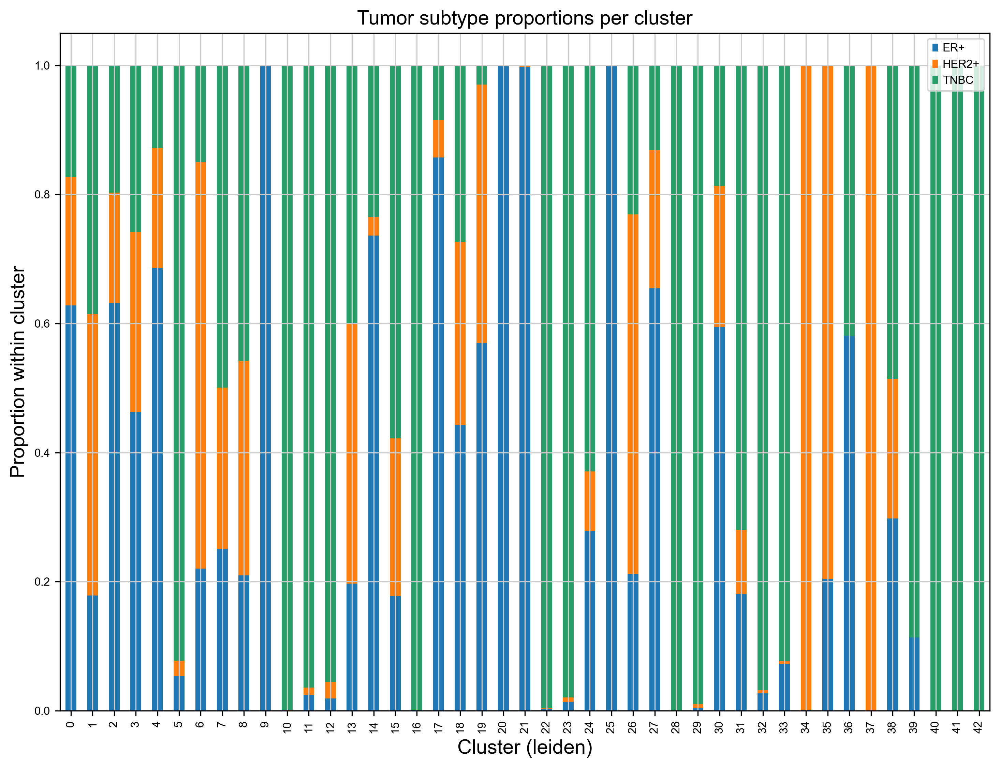

Saved: /Users/prabhasavvaru/Downloads/Wu_etal_2021_BRCA_scRNASeq_outputs_3/subtype_cluster_summary_stacked_proportions.pdf /Users/prabhasavvaru/Downloads/Wu_etal_2021_BRCA_scRNASeq_outputs_3/subtype_cluster_summary_stacked_proportions.png


In [6]:
import matplotlib.pyplot as plt
import pandas as pd
from pathlib import Path

# -------------------------
# Example: compute cluster × subtype proportions
# -------------------------
# Suppose your adata.obs has columns: "leiden_clusters" and "subtype"
# You can compute proportions like this:
props = (
    pd.crosstab(adata.obs["leiden_clusters"], adata.obs["subtype"], normalize="index")
)

# -------------------------
# Plotting
# -------------------------
OUTPUT_PATH = Path(OUTPUT_PATH) if not isinstance(OUTPUT_PATH, Path) else OUTPUT_PATH
OUTPUT_PATH.mkdir(parents=True, exist_ok=True)

ax = props.plot(
    kind="bar",
    stacked=True,
    legend=True,
    figsize=(10, max(4, len(props.index) * 0.18))
)
ax.set_xlabel("Cluster (leiden)")
ax.set_ylabel("Proportion within cluster")
ax.set_title("Tumor subtype proportions per cluster")

# make x tick labels smaller
ax.set_xticklabels(ax.get_xticklabels(), fontsize=8)

# optionally make legend/text smaller
ax.legend(fontsize=8)
ax.tick_params(axis="y", labelsize=8)

plt.tight_layout()
out_pdf = OUTPUT_PATH / "subtype_cluster_summary_stacked_proportions.pdf"
out_png = OUTPUT_PATH / "subtype_cluster_summary_stacked_proportions.png"
plt.savefig(str(out_pdf), bbox_inches="tight", dpi=300)
plt.savefig(str(out_png), bbox_inches="tight", dpi=150)

try:
    plt.show()
except Exception:
    pass
plt.close()

print("Saved:", out_pdf, out_png)


In [7]:
import pandas as pd

# Load your metadata
meta = pd.read_csv("/Users/prabhasavvaru/Downloads/Wu_etal_2021_BRCA_scRNASeq_outputs_3/GSE176078_metadata_v2.csv")

# Create a mapping table of Cluster Number -> Cell Type
cluster_mapping = meta.groupby(['leiden_clusters', 'celltype_major']).size().reset_index(name='count')

# Sort by cluster number to make it readable
print(cluster_mapping.sort_values('leiden_clusters'))

     leiden_clusters     celltype_major  count
0                  0            B-cells      5
1                  0        Endothelial      4
2                  0            Myeloid      3
3                  0       Plasmablasts      2
4                  0            T-cells   6789
..               ...                ...    ...
169               40  Normal Epithelial      1
168               40  Cancer Epithelial    130
170               41            T-cells    127
171               42               CAFs      6
172               42                PVL     87

[173 rows x 3 columns]


In [8]:
import pandas as pd

# Load the metadata
meta = pd.read_csv("/Users/prabhasavvaru/Downloads/Wu_etal_2021_BRCA_scRNASeq_outputs_3/GSE176078_metadata_v2.csv")

# Create a clean mapping table
cluster_map = meta[['leiden_clusters', 'celltype_major']].drop_duplicates().sort_values('leiden_clusters')

# Configure pandas to show all rows (so it's scrollable, not truncated)
pd.set_option('display.max_rows', None)

# Display the full list
display(cluster_map.set_index('leiden_clusters'))

,celltype_major
leiden_clusters,
0,Myeloid
0,B-cells
0,Plasmablasts
0,Endothelial
0,T-cells
1,B-cells
1,Myeloid
1,T-cells
2,Endothelial


In [9]:
import pandas as pd

# Load your metadata
df = pd.read_csv("/Users/prabhasavvaru/Downloads/Wu_etal_2021_BRCA_scRNASeq_outputs_3/GSE176078_metadata_v2.csv")

# Group by Cluster AND Detailed Cell Type
# This shows you exactly what "Cluster 1" or "Cluster 15" actually is
detailed_map = df.groupby(['leiden_clusters', 'celltype_major', 'celltype_minor']).size().reset_index(name='cell_count')

# Sort so it's easy to read (0, 1, 2...)
print(detailed_map.sort_values('leiden_clusters').to_string())

     leiden_clusters     celltype_major               celltype_minor  cell_count
0                  0            B-cells               B cells Memory           5
1                  0        Endothelial            Endothelial ACKR1           1
2                  0        Endothelial  Endothelial Lymphatic LYVE1           3
3                  0            Myeloid                          DCs           3
4                  0       Plasmablasts                 Plasmablasts           2
5                  0            T-cells              Cycling T-cells          89
6                  0            T-cells                     NK cells         481
7                  0            T-cells                    NKT cells         488
8                  0            T-cells                 T cells CD4+        3881
9                  0            T-cells                 T cells CD8+        1850
17                 1            T-cells                 T cells CD4+         571
16                 1        

... storing 'tumor_subtype' as categorical
... storing 'cell_type_assigned' as categorical


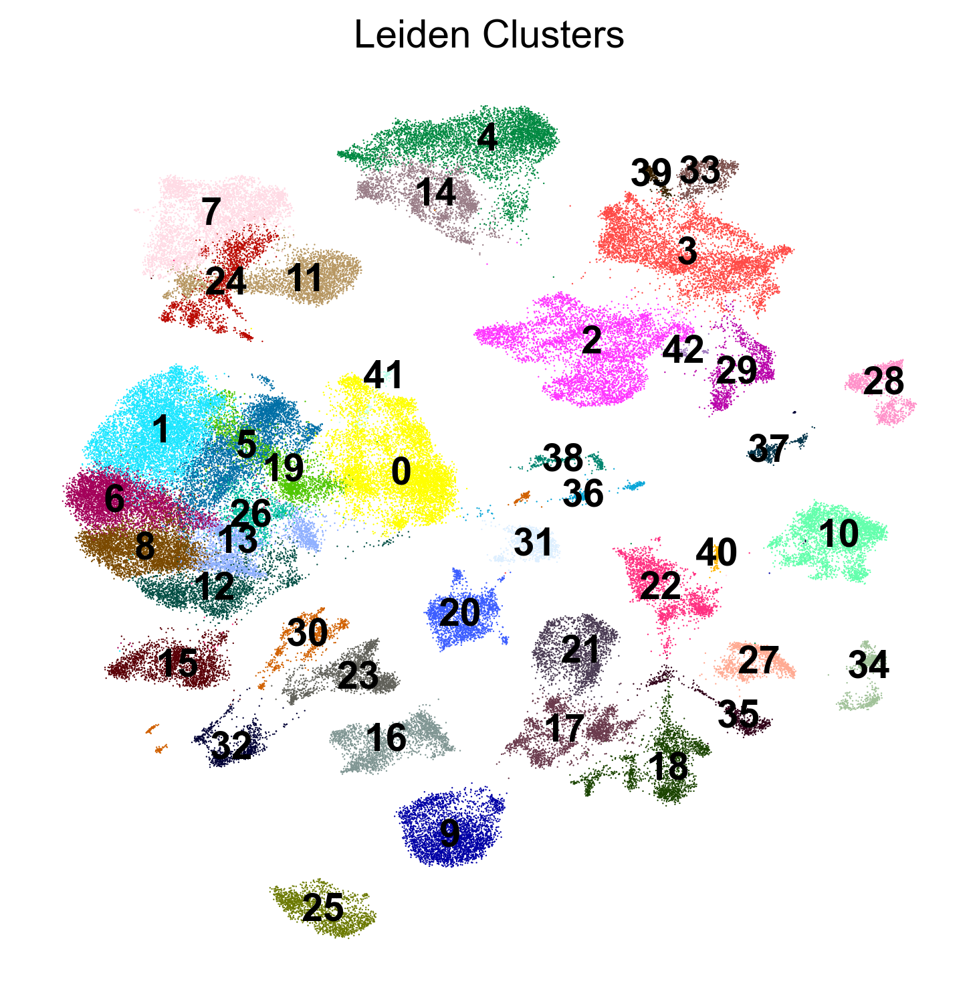

In [10]:
import scanpy as sc
import matplotlib.pyplot as plt

# FIXED CODE: matches the column name in your metadata file
sc.pl.umap(
    adata, 
    color="leiden_clusters",  # <--- Changed from 'leiden' to 'leiden_clusters'
    legend_loc="on data", 
    title="Leiden Clusters",
    frameon=False,
    save="_leiden_clusters_labeled.pdf"
)

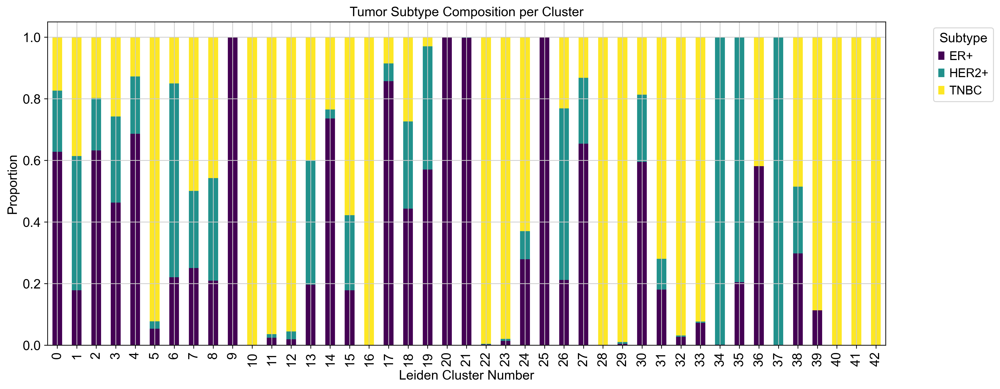

In [11]:
import pandas as pd
import matplotlib.pyplot as plt

# 1. Create the crosstab (Use 'leiden_clusters' instead of 'leiden')
cluster_subtype_counts = pd.crosstab(
    adata.obs['leiden_clusters'],  # <--- FIXED HERE
    adata.obs['subtype'], 
    normalize='index'
)

# 2. Plot stacked bar chart
ax = cluster_subtype_counts.plot(
    kind='bar', 
    stacked=True, 
    figsize=(15, 6), 
    colormap='viridis'
)

# 3. Formatting
plt.xlabel("Leiden Cluster Number")
plt.ylabel("Proportion")
plt.title("Tumor Subtype Composition per Cluster")
plt.legend(title="Subtype", bbox_to_anchor=(1.05, 1))
plt.tight_layout()

# 4. Show
plt.show()

In [12]:
import pandas as pd

# 1. Grab the relevant columns from your data
# We assume 'adata' is your main object in the notebook
detailed_info = adata.obs[[
    'leiden_clusters',    # The Number (0, 1, 2...)
    'celltype_major',     # The Broad Name (e.g., T cells)
    'celltype_minor',     # The Detailed Name (e.g., T_cells_CD8_GZMB)
    'subtype'             # The Patient Type (TNBC, HER2, etc.)
]].copy()

# 2. Rename columns to be super clear
detailed_info.columns = ['Cluster_Number', 'Broad_Type', 'Detailed_Type', 'Tumor_Subtype']

# 3. Sort by Cluster Number so it's organized
detailed_info = detailed_info.sort_values('Cluster_Number')

# 4. Save to a new file you can open in Excel
detailed_info.to_csv("Master_Cell_Annotations.csv")

print("Success! Saved 'Master_Cell_Annotations.csv'.")
print(detailed_info.head())

Success! Saved 'Master_Cell_Annotations.csv'.
                         Cluster_Number Broad_Type Detailed_Type Tumor_Subtype
CID4398_GAAATGAAGGTGCTAG              0    T-cells  T cells CD4+           ER+
CID4515_ACACCGGAGGTAAACT              0    T-cells      NK cells          TNBC
CID4515_CATATTCAGGTGCACA              0    T-cells      NK cells          TNBC
CID4515_ATCTACTCAGTGGAGT              0    T-cells      NK cells          TNBC
CID4515_TCAACGAGTTGGAGGT              0    T-cells      NK cells          TNBC


In [13]:
import pandas as pd
from scipy import io
import scanpy as sc

# 1. Filter the AnnData object to keep ONLY the Highly Variable Genes (HVGs)
# This creates a 'view' of your data with 93,835 cells x 3,012 genes
adata_hvg = adata[:, adata.var['highly_variable']]

print(f"Exporting matrix with shape: {adata_hvg.shape}") 
# Should print: (93835, 3012)

# 2. Save the Matrix (.mtx)
# This is the actual grid of numbers (expression values)
# Note: This exports 'adata.X' (your normalized/imputed data)
io.mmwrite("hvg_expression_matrix.mtx", adata_hvg.X)

# 3. Save the Barcodes (Cells)
# Each row in the matrix corresponds to one of these cells
with open("hvg_barcodes.tsv", "w") as f:
    for item in adata_hvg.obs_names:
        f.write("%s\n" % item)

# 4. Save the Features (Genes)
# Each column in the matrix corresponds to one of these 3,012 genes
# We save both the Gene ID and Gene Symbol (if available)
genes_df = adata_hvg.var.reset_index()
genes_df.to_csv("hvg_genes.tsv", sep="\t", index=False, header=False)

print("Success! Created 'hvg_expression_matrix.mtx', 'hvg_barcodes.tsv', and 'hvg_genes.tsv'.")

Exporting matrix with shape: (93835, 3012)
Success! Created 'hvg_expression_matrix.mtx', 'hvg_barcodes.tsv', and 'hvg_genes.tsv'.


In [14]:
import pandas as pd
import scipy.io

print("--- Loading Files ---")

# 1. Load the Matrix (The Numbers)
# We use .tocsr() to make it faster to slice
matrix = scipy.io.mmread("hvg_expression_matrix.mtx").tocsr()

# 2. Load the Labels (Cells and Genes)
# Note: Adjust column numbers [0] or [1] depending on your file structure
genes = pd.read_csv("hvg_genes.tsv", header=None, sep="\t")[0].values  # Gene Names
cells = pd.read_csv("hvg_barcodes.tsv", header=None)[0].values         # Cell Barcodes

# 3. Create a "Peek" View
# We take only the first 10 cells and 10 genes to avoid crashing memory
small_slice = matrix[:10, :10].toarray()

# 4. Make it a readable Table
df_view = pd.DataFrame(small_slice, index=cells[:10], columns=genes[:10])

print(f"Successfully loaded matrix with dimensions: {matrix.shape}")
print("(Rows = Cells, Columns = Genes)")
print("\n--- PREVIEW: Expression Values (First 10x10) ---")
display(df_view)

# 5. Check a specific gene (Optional)
# This finds the max expression of the 1st gene to see if data is normalized
max_val = matrix[:, 0].max()
print(f"\nMax expression value for gene '{genes[0]}': {max_val:.4f}")
if max_val < 20:
    print("-> Looks like Log-Normalized data (Floats).")
else:
    print("-> Looks like Raw Counts (Integers).")

--- Loading Files ---
Successfully loaded matrix with dimensions: (93835, 3012)
(Rows = Cells, Columns = Genes)

--- PREVIEW: Expression Values (First 10x10) ---


,TNFRSF18,TNFRSF4,FAM132A,MXRA8,VWA1,GABRD,HES5,TNFRSF25,UTS2,TNFRSF9
CID3586_AAGACCTCAGCATGAG,0.0,0.0,0.0,0.0,1.157802,0.0,0.0,0.000000,0.0,0.0
CID3586_AAGGTTCGTAGTACCT,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.000000,0.0,0.0
CID3586_ACCAGTAGTTGTGGCC,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.000000,0.0,0.0
CID3586_ACCCACTAGATGTCGG,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.000000,0.0,0.0
CID3586_ACTGATGGTCAACTGT,0.0,0.0,0.0,0.0,2.919586,0.0,0.0,1.923451,0.0,0.0
CID3586_ACTTGTTAGGGAAACA,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.000000,0.0,0.0
CID3586_AGCAGCCTCCCTCTTT,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.000000,0.0,0.0
CID3586_AGCTTGATCGGCGCTA,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.000000,0.0,0.0
CID3586_ATCATCTAGGGATACC,0.0,0.0,0.0,0.0,1.984782,0.0,0.0,0.000000,0.0,0.0
CID3586_ATGGGAGAGGAGCGAG,0.0,0.0,0.0,0.0,3.278021,0.0,0.0,0.000000,0.0,0.0



Max expression value for gene 'TNFRSF18': 4.5660
-> Looks like Log-Normalized data (Floats).


In [15]:
import pandas as pd
import scipy.io
import numpy as np

# 1. Load the Data (Sparse - Low Memory)
print("Loading sparse matrix...")
matrix = scipy.io.mmread("hvg_expression_matrix.mtx").tocsr()
genes = pd.read_csv("hvg_genes.tsv", header=None, sep="\t")[0].values
cells = pd.read_csv("hvg_barcodes.tsv", header=None)[0].values

# 2. Setup the Output File
output_filename = "FULL_gene_expression.csv"
chunk_size = 1000  # Process 1000 cells at a time
total_cells = matrix.shape[0]

print(f"Starting export of {total_cells} cells to '{output_filename}'...")

# 3. Create the File and Write the Header (Gene Names)
# We open in 'w' mode first to overwrite any old file
with open(output_filename, 'w') as f:
    # Write "Cell_ID" + all gene names separated by commas
    header = "Cell_ID," + ",".join(genes) + "\n"
    f.write(header)

# 4. Loop through Data in Chunks
for i in range(0, total_cells, chunk_size):
    # Define the slice (e.g., 0 to 1000, then 1000 to 2000)
    start = i
    end = min(i + chunk_size, total_cells)
    
    # Grab just this small chunk and make it dense (Safe!)
    chunk_dense = matrix[start:end, :].toarray()
    chunk_cells = cells[start:end]
    
    # Create a temporary DataFrame for this chunk
    df_chunk = pd.DataFrame(chunk_dense, index=chunk_cells)
    
    # Append to the CSV
    # mode='a' means append; header=False because we already wrote the header
    df_chunk.to_csv(output_filename, mode='a', header=False)
    
    # Print progress every 5,000 cells
    if end % 5000 == 0:
        print(f"Exported {end}/{total_cells} cells...")

print("Done! 'FULL_gene_expression.csv' is ready.")

Loading sparse matrix...
Starting export of 93835 cells to 'FULL_gene_expression.csv'...
Exported 5000/93835 cells...
Exported 10000/93835 cells...
Exported 15000/93835 cells...
Exported 20000/93835 cells...
Exported 25000/93835 cells...
Exported 30000/93835 cells...
Exported 35000/93835 cells...
Exported 40000/93835 cells...
Exported 45000/93835 cells...
Exported 50000/93835 cells...
Exported 55000/93835 cells...
Exported 60000/93835 cells...
Exported 65000/93835 cells...
Exported 70000/93835 cells...
Exported 75000/93835 cells...
Exported 80000/93835 cells...
Exported 85000/93835 cells...
Exported 90000/93835 cells...
Done! 'FULL_gene_expression.csv' is ready.


--- BEFORE QC PLOTS ---
Loading raw data...


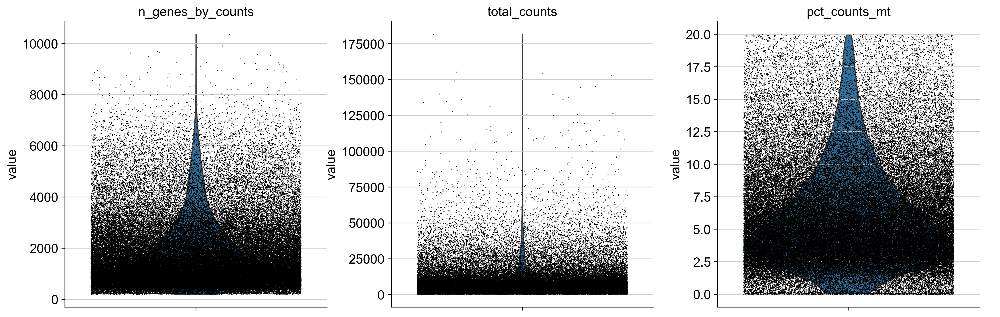


--- AFTER QC PLOTS ---
Using 'adata' currently in memory.


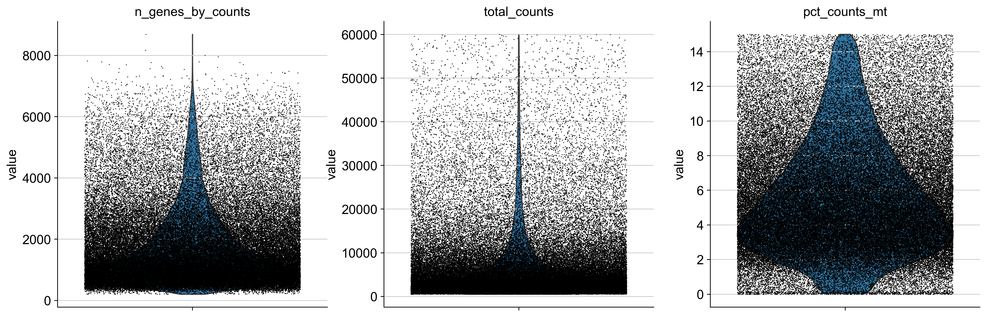

In [16]:
import scanpy as sc
import pandas as pd
import matplotlib.pyplot as plt
import gc
from pathlib import Path

# ==========================================
# 1. Setup Paths (Hardcoded to match your notebook defaults)
# ==========================================
# We define these explicitly to avoid NameError if previous cells weren't run
BASE_PATH = Path.home() / "Downloads" / "Wu_etal_2021_BRCA_scRNASeq"
OUTPUT_PATH = Path.home() / "Downloads" / "Wu_etal_2021_BRCA_scRNASeq_outputs"

MTX_PATH = BASE_PATH / "count_matrix_sparse.mtx"
GENES_PATH = BASE_PATH / "count_matrix_genes.tsv"
BARCODES_PATH = BASE_PATH / "count_matrix_barcodes.tsv"
H5AD_PATH = OUTPUT_PATH / "annotated_brca_object.h5ad"

# ==========================================
# 2. Load & Plot "Before QC" (Raw Data)
# ==========================================
print("--- BEFORE QC PLOTS ---")
try:
    if not MTX_PATH.exists():
        print(f"WARNING: Raw data file not found at {MTX_PATH}")
        print("Cannot plot 'Before QC'. Check if your BASE_PATH is correct.")
    else:
        print("Loading raw data...")
        # Load raw matrix
        adata_raw = sc.read_mtx(str(MTX_PATH)).T
        genes = pd.read_csv(GENES_PATH, header=None, sep="\t")[0].astype(str)
        barcodes = pd.read_csv(BARCODES_PATH, header=None, sep="\t")[0].astype(str)
        adata_raw.var_names = genes
        adata_raw.obs_names = barcodes
        
        # Calculate QC metrics
        adata_raw.var["mt"] = adata_raw.var_names.str.upper().str.startswith("MT-")
        sc.pp.calculate_qc_metrics(adata_raw, qc_vars=["mt"], inplace=True)
        
        # Plot
        sc.pl.violin(adata_raw, ['n_genes_by_counts', 'total_counts', 'pct_counts_mt'],
                     jitter=0.4, multi_panel=True, show=True)
        
        # Cleanup to save memory
        del adata_raw
        gc.collect()

except Exception as e:
    print(f"An error occurred loading raw data: {e}")

# ==========================================
# 3. Plot "After QC" (Filtered Data)
# ==========================================
print("\n--- AFTER QC PLOTS ---")

# Check if 'adata' is already in memory (from running the pipeline)
if 'adata' in locals():
    print("Using 'adata' currently in memory.")
    target_adata = adata
# If not, try to load the saved output file
elif H5AD_PATH.exists():
    print(f"Loading 'adata' from saved file: {H5AD_PATH}")
    target_adata = sc.read_h5ad(str(H5AD_PATH))
else:
    target_adata = None
    print("ERROR: Could not find 'adata' in memory or on disk.")

# Generate Plot
if target_adata is not None:
    # Ensure QC metrics exist (calculate if missing)
    if 'pct_counts_mt' not in target_adata.obs:
         target_adata.var["mt"] = target_adata.var_names.str.upper().str.startswith("MT-")
         sc.pp.calculate_qc_metrics(target_adata, qc_vars=["mt"], inplace=True)

    sc.pl.violin(target_adata, ['n_genes_by_counts', 'total_counts', 'pct_counts_mt'],
                 jitter=0.4, multi_panel=True, show=True)

Loading /Users/prabhasavvaru/Downloads/Wu_etal_2021_BRCA_scRNASeq_outputs/annotated_brca_object.h5ad...
File loaded successfully.
Using existing PCA coordinates.
Generating PCA plot...


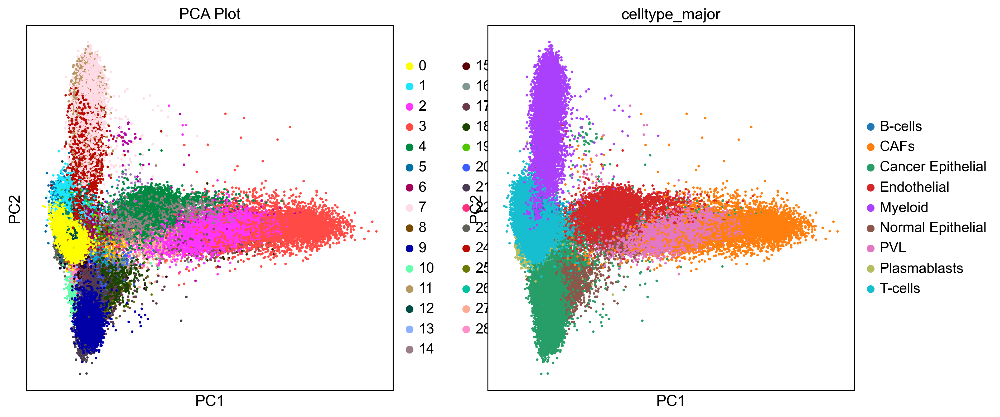

In [17]:
import scanpy as sc
import matplotlib.pyplot as plt

# 1. Load the AnnData object
filename = '/Users/prabhasavvaru/Downloads/Wu_etal_2021_BRCA_scRNASeq_outputs/annotated_brca_object.h5ad'

print(f"Loading {filename}...")
try:
    adata = sc.read_h5ad(filename)
    print("File loaded successfully.")

    # 2. Check if PCA is already calculated; if not, calculate it
    if 'X_pca' not in adata.obsm.keys():
        print("PCA coordinates not found in .obsm['X_pca']. Calculating PCA now...")
        # Optional: Normalize and log transform if not already done
        # sc.pp.normalize_total(adata, target_sum=1e4)
        # sc.pp.log1p(adata)
        sc.tl.pca(adata, svd_solver='arpack')
    else:
        print("Using existing PCA coordinates.")

    # 3. Determine which columns to use for coloring the plot
    # We look for the columns mentioned in your notebook
    available_keys = adata.obs.columns
    color_keys = []
    
    if 'leiden_clusters' in available_keys:
        color_keys.append('leiden_clusters')
    if 'celltype_major' in available_keys:
        color_keys.append('celltype_major')
    
    # If those specific keys aren't found, we just plot the geometry without coloring
    if not color_keys:
        color_keys = None 

    # 4. Generate the PCA Plot
    print("Generating PCA plot...")
    sc.pl.pca(
        adata, 
        color=color_keys,    # Colors points by cluster/cell type if found
        title="PCA Plot",
        size=20,             # Adjust dot size
        show=True            # Show the plot immediately
    )

except FileNotFoundError:
    print(f"Error: The file '{filename}' was not found in the current directory.")
except Exception as e:
    print(f"An error occurred: {e}")

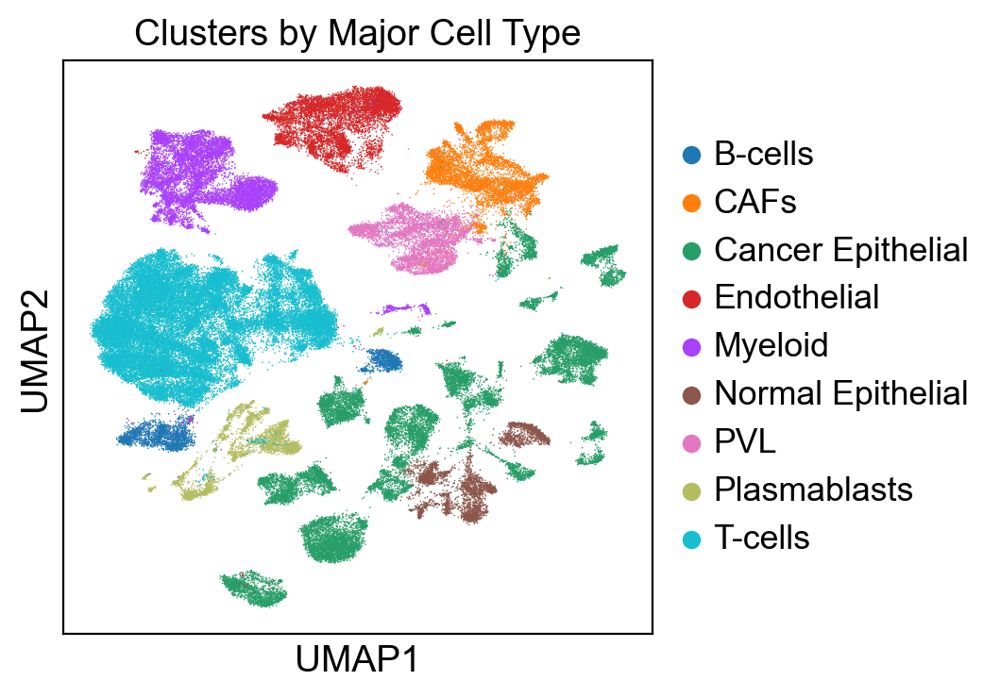

In [18]:
import scanpy as sc

# Load your AnnData object (replace 'filename.h5ad' with your actual file path)
# adata = sc.read_h5ad('your_data_file.h5ad')

# Set the figure parameters for better quality
sc.set_figure_params(dpi=100, color_map='viridis', vector_friendly=True, format='pdf')

# Plotting the clusters by 'celltype_major'
# If you have run UMAP, use sc.pl.umap. If not, you can use sc.pl.pca as seen in your code.
sc.pl.umap(adata, color=['celltype_major'], title='Clusters by Major Cell Type', show=True)

# Alternatively, if you want to see specific subtypes:
# sc.pl.umap(adata, color=['subtype'], title='Clusters by Subtype', show=True)

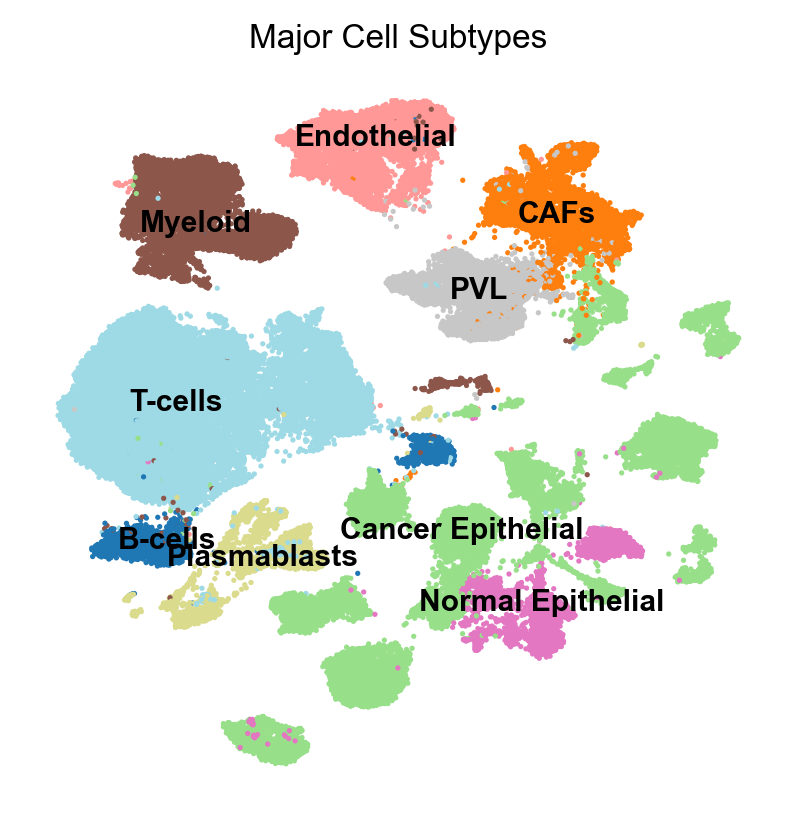

In [19]:
import scanpy as sc
import matplotlib.pyplot as plt

# 1. Standard visual settings for a "publication look"
sc.set_figure_params(dpi=120, frameon=False, vector_friendly=True, fontsize=10)

# 2. Ensure neighbors and UMAP are calculated 
# (If you've already done this, you can skip these two lines)
sc.pp.neighbors(adata, n_neighbors=15, use_rep='X_pca')
sc.tl.umap(adata)

# 3. Plotting Major Subtypes
# 'palette' allows you to use distinct color schemes like 'tab20' or 'Set1'
sc.pl.umap(
    adata, 
    color='celltype_major', 
    title='Major Cell Subtypes',
    palette='tab20',      # Gives high-contrast colors for different clusters
    size=10,              # Adjust point size so they don't overlap too much
    legend_fontsize=9,
    legend_loc='on data', # Optional: puts labels directly on the clusters
    frameon=False,
    save='_major_subtypes.pdf' # Saves a high-res version
)

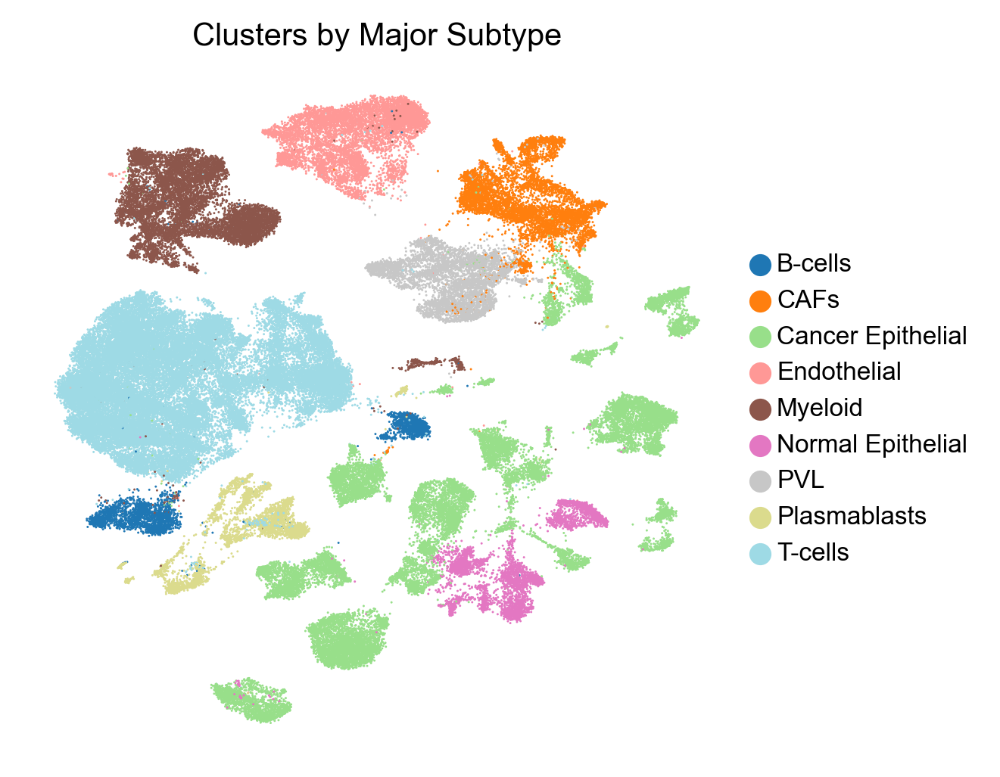

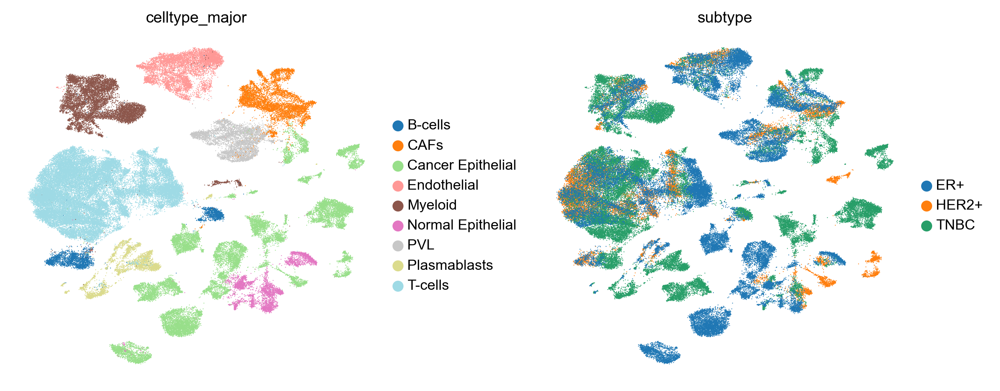

In [20]:
import scanpy as sc
import matplotlib.pyplot as plt

# Load processed AnnData
adata = sc.read_h5ad('/Users/prabhasavvaru/Downloads/Wu_etal_2021_BRCA_scRNASeq_outputs_3/annotated_brca_object.h5ad')

# Set figure directory for saving outputs
sc.settings.figdir = '/Users/prabhasavvaru/Downloads/Wu_etal_2021_BRCA_scRNASeq_outputs_3'

# Publication-style settings
sc.set_figure_params(dpi=150, frameon=False, vector_friendly=True, fontsize=10)

# UMAP by major cell types
sc.pl.umap(
    adata,
    color='celltype_major',
    title='Clusters by Major Subtype',
    palette='tab20',
    size=2,
    legend_fontsize=8,
    legend_fontoutline=2,
    frameon=False,
    save='_major_subtypes_plot.png'
)

# Side-by-side UMAPs: celltype_major vs subtype
sc.pl.umap(
    adata,
    color=['celltype_major', 'subtype'],
    ncols=2,
    wspace=0.3,
    save='_comparison_plot.png'
)


In [21]:
import matplotlib.pyplot as plt
import scanpy as sc

# Make sure UMAP is already computed
assert "X_umap" in adata.obsm, "UMAP not found. Run sc.tl.umap(adata) first."

# Define subtypes
subtypes = ["ER+", "HER2+", "TNBC"]

# Create output folder if needed
from pathlib import Path
OUTPUT_PATH = Path(OUTPUT_PATH) if not isinstance(OUTPUT_PATH, Path) else OUTPUT_PATH
OUTPUT_PATH.mkdir(parents=True, exist_ok=True)

# Loop through each subtype and plot
for subtype in subtypes:
    # Filter cells of this subtype
    mask = adata.obs["subtype"] == subtype
    adata_sub = adata[mask].copy()

    # Plot UMAP for this subtype
    sc.pl.umap(
        adata_sub,
        color="celltype_major",  # or any other annotation you want to show
        title=f"UMAP of {subtype} cells",
        save=f"_{subtype.replace('+', 'pos')}_umap.pdf",  # saves to OUTPUT_PATH
        show=False
    )

    # Optional: also save as PNG
    plt.savefig(OUTPUT_PATH / f"{subtype.replace('+', 'pos')}_umap.png", dpi=150)
    plt.close()

print("Saved UMAP plots for:", ", ".join(subtypes))


Saved UMAP plots for: ER+, HER2+, TNBC


In [22]:
import matplotlib.pyplot as plt
import scanpy as sc
from pathlib import Path

# Make sure UMAP is already computed
assert "X_umap" in adata.obsm, "UMAP not found. Run sc.tl.umap(adata) first."

# Define subtypes
subtypes = ["ER+", "HER2+", "TNBC"]

# Create output folder if needed
OUTPUT_PATH = Path(OUTPUT_PATH) if not isinstance(OUTPUT_PATH, Path) else OUTPUT_PATH
OUTPUT_PATH.mkdir(parents=True, exist_ok=True)

# Set global matplotlib style for dark theme
plt.style.use("dark_background")  # sets black bg and white text

# Loop through each subtype and plot
for subtype in subtypes:
    # Filter cells of this subtype
    mask = adata.obs["subtype"] == subtype
    adata_sub = adata[mask].copy()

    # Plot UMAP for this subtype
    sc.pl.umap(
        adata_sub,
        color="celltype_major",
        title=f"UMAP of {subtype} cells",
        show=False,
        save=f"_{subtype.replace('+', 'pos')}_umap_dark.pdf"
    )

    # Save as PNG manually
    plt.savefig(OUTPUT_PATH / f"{subtype.replace('+', 'pos')}_umap_dark.png", dpi=150, bbox_inches="tight")
    plt.close()

print("Saved dark-themed UMAP plots for:", ", ".join(subtypes))


Saved dark-themed UMAP plots for: ER+, HER2+, TNBC


In [23]:
import scanpy as sc
import os

# 1. Subset for only Cancer Epithelial cells
# This isolates the malignant cells from the rest of the clusters
adata_cancer = adata[adata.obs['celltype_major'] == 'Cancer Epithelial'].copy()

print(f"Total Cancer Epithelial cells: {adata_cancer.n_obs}")

# 2. Define the subtypes we want to export
# Based on your metadata, these should match the names in adata.obs['subtype']
subtypes_to_export = {
    'ER+': 'ER+', 
    'HER2+': 'HER2+', 
    'TNBC': 'TNBC'
}

# 3. Create and save separate .h5ad files for each subtype
output_dir = "subtype_files"
if not os.path.exists(output_dir):
    os.makedirs(output_dir)

for name, label in subtypes_to_export.items():
    # Subset the cancer cells for the specific clinical subtype
    adata_subset = adata_cancer[adata_cancer.obs['subtype'] == label].copy()
    
    # Define filename
    filename = f"{output_dir}/cancer_epithelial_{name.lower().replace('+', 'plus')}.h5ad"
    
    # Save the file
    adata_subset.write(filename)
    print(f"Saved {name} data ({adata_subset.n_obs} cells) to {filename}")

# Optional: Also save as CSV if you need it for other tools
# adata_subset.to_df().to_csv(f"{output_dir}/cancer_epithelial_{name}.csv")

Total Cancer Epithelial cells: 21169
Saved ER+ data (10202 cells) to subtype_files/cancer_epithelial_erplus.h5ad
Saved HER2+ data (1513 cells) to subtype_files/cancer_epithelial_her2plus.h5ad
Saved TNBC data (9454 cells) to subtype_files/cancer_epithelial_tnbc.h5ad


In [24]:
import pandas as pd
import scanpy as sc

# 1. First, isolate the cancer cells from your main 'adata' object
adata_cancer = adata[adata.obs['celltype_major'] == 'Cancer Epithelial'].copy()

# 2. Explicitly create the variables the loop is looking for
adata_erplus = adata_cancer[adata_cancer.obs['subtype'] == 'ER+'].copy()
adata_her2plus = adata_cancer[adata_cancer.obs['subtype'] == 'HER2+'].copy()
adata_tnbc = adata_cancer[adata_cancer.obs['subtype'] == 'TNBC'].copy()

# 3. Now run the export loop
subsets = {
    'ERplus': adata_erplus,
    'HER2plus': adata_her2plus,
    'TNBC': adata_tnbc
}

for name, ad in subsets.items():
    print(f"Exporting {name} (Size: {ad.n_obs} cells x {ad.n_vars} genes) to CSV...")
    
    # Extract expression matrix (X) to a DataFrame
    # We use .toarray() because Scanpy usually stores data in a memory-efficient 'sparse' format
    if hasattr(ad.X, "toarray"):
        df = pd.DataFrame(ad.X.toarray(), index=ad.obs_names, columns=ad.var_names)
    else:
        df = pd.DataFrame(ad.X, index=ad.obs_names, columns=ad.var_names)
    
    # Save the file
    output_path = f"cancer_expression_{name}.csv"
    df.to_csv(output_path)
    print(f"Successfully saved: {output_path}")

Exporting ERplus (Size: 10202 cells x 3012 genes) to CSV...
Successfully saved: cancer_expression_ERplus.csv
Exporting HER2plus (Size: 1513 cells x 3012 genes) to CSV...
Successfully saved: cancer_expression_HER2plus.csv
Exporting TNBC (Size: 9454 cells x 3012 genes) to CSV...
Successfully saved: cancer_expression_TNBC.csv


In [29]:
import scanpy as sc
import pandas as pd

# --- STEP 1: Load the saved .h5ad files ---
print("Loading H5AD files...")
# Using the exact paths from your log output
adata_er   = sc.read_h5ad('subtype_files/cancer_epithelial_erplus.h5ad')
adata_her2 = sc.read_h5ad('subtype_files/cancer_epithelial_her2plus.h5ad')
adata_tnbc = sc.read_h5ad('subtype_files/cancer_epithelial_tnbc.h5ad')

# --- STEP 2: Combine them into one object ---
print("Combining data...")

# We use sc.concat with a dictionary. 
# The keys ('ER+', 'HER2+', 'TNBC') will automatically become the labels in the new 'subtype' column.
adata_combined = sc.concat(
    {'ER+': adata_er, 'HER2+': adata_her2, 'TNBC': adata_tnbc}, 
    label='subtype',   # This creates a new column named 'subtype' with the keys above
    join='outer'       # Keeps all genes
)

# Recover the original indices (cell names) if needed
adata_combined.obs_names_make_unique()

print(f"Combined data shape: {adata_combined.shape}")
print(f"Groups found: {adata_combined.obs['subtype'].unique().tolist()}")

# --- STEP 3: Run DEG Analysis ---

# Analysis 1: TNBC vs Others (Rest)
print("\n1. Running DEG: TNBC vs Others...")
sc.tl.rank_genes_groups(adata_combined, groupby='subtype', groups=['TNBC'], reference='rest', method='wilcoxon')

# Save results
tnbc_vs_others = sc.get.rank_genes_groups_df(adata_combined, group='TNBC')
tnbc_vs_others.to_csv('deg_TNBC_vs_Others.csv', index=False)
print("Saved: deg_TNBC_vs_Others.csv")

# Analysis 2: TNBC vs HER2+ (Direct Comparison)
print("\n2. Running DEG: TNBC vs HER2+...")
sc.tl.rank_genes_groups(adata_combined, groupby='subtype', groups=['TNBC'], reference='HER2+', method='wilcoxon')

# Save results
tnbc_vs_her2 = sc.get.rank_genes_groups_df(adata_combined, group='TNBC')
tnbc_vs_her2.to_csv('deg_TNBC_vs_HER2_plus.csv', index=False)
print("Saved: deg_TNBC_vs_HER2_plus.csv")

print("\nAll done! Files are saved in your folder.")

Loading H5AD files...
Combining data...
Combined data shape: (21169, 3012)
Groups found: ['ER+', 'HER2+', 'TNBC']

1. Running DEG: TNBC vs Others...
Saved: deg_TNBC_vs_Others.csv

2. Running DEG: TNBC vs HER2+...
Saved: deg_TNBC_vs_HER2_plus.csv

All done! Files are saved in your folder.


Running DEG: TNBC vs ER+...
Success: Saved 'deg_TNBC_vs_ER_plus.csv'

Generating plots...


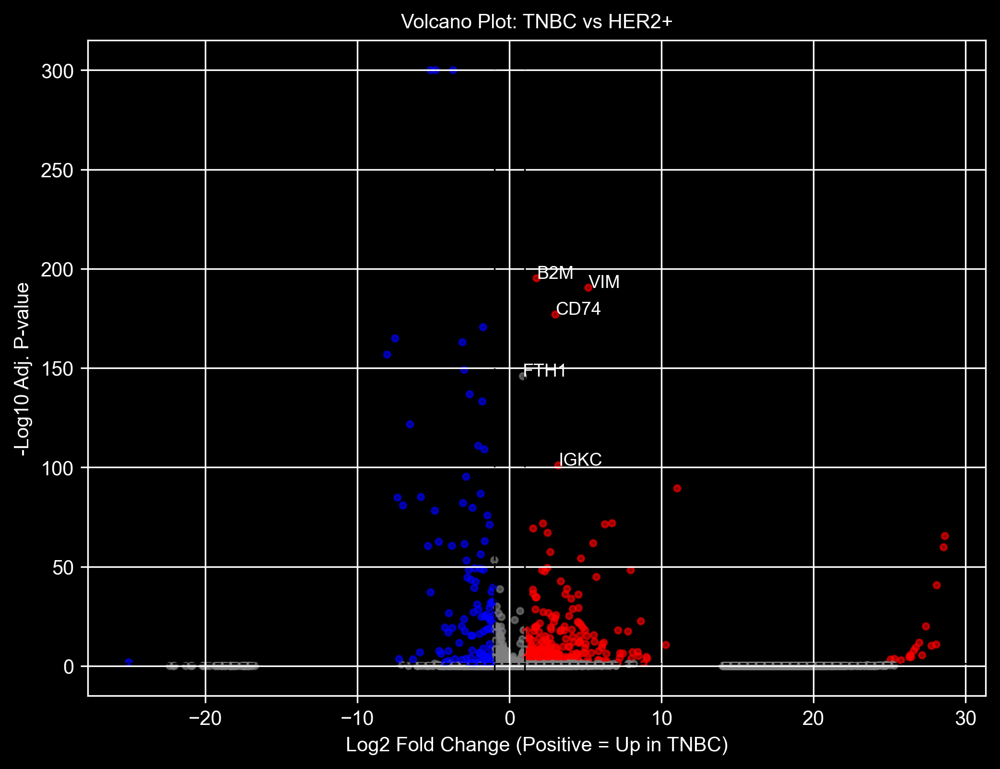

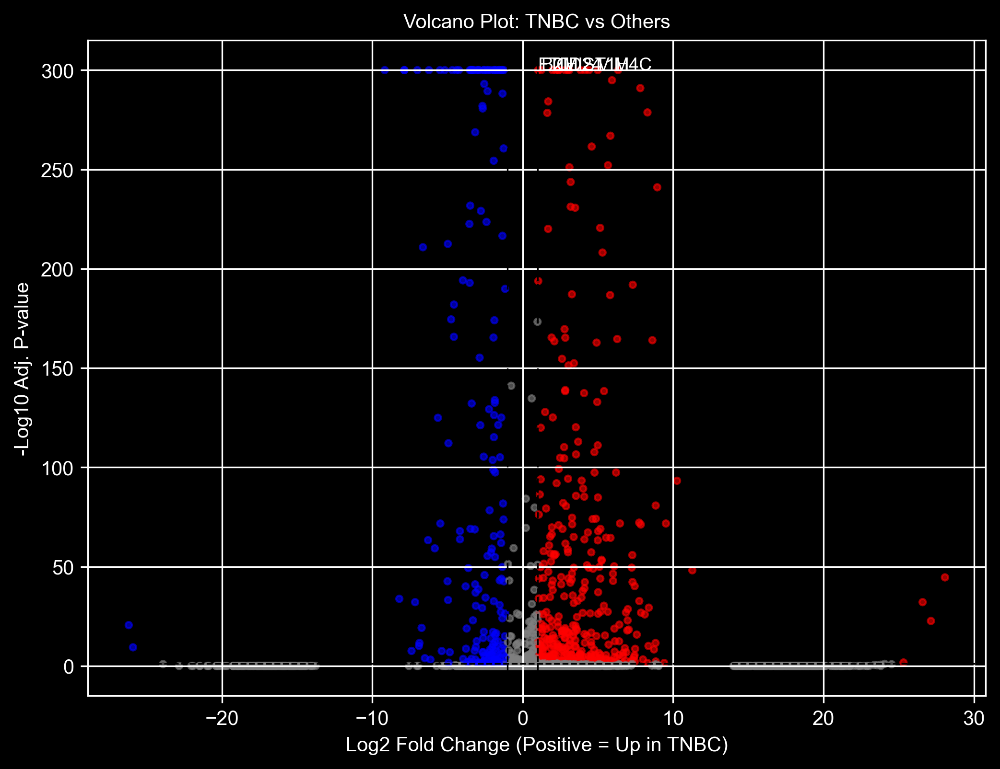

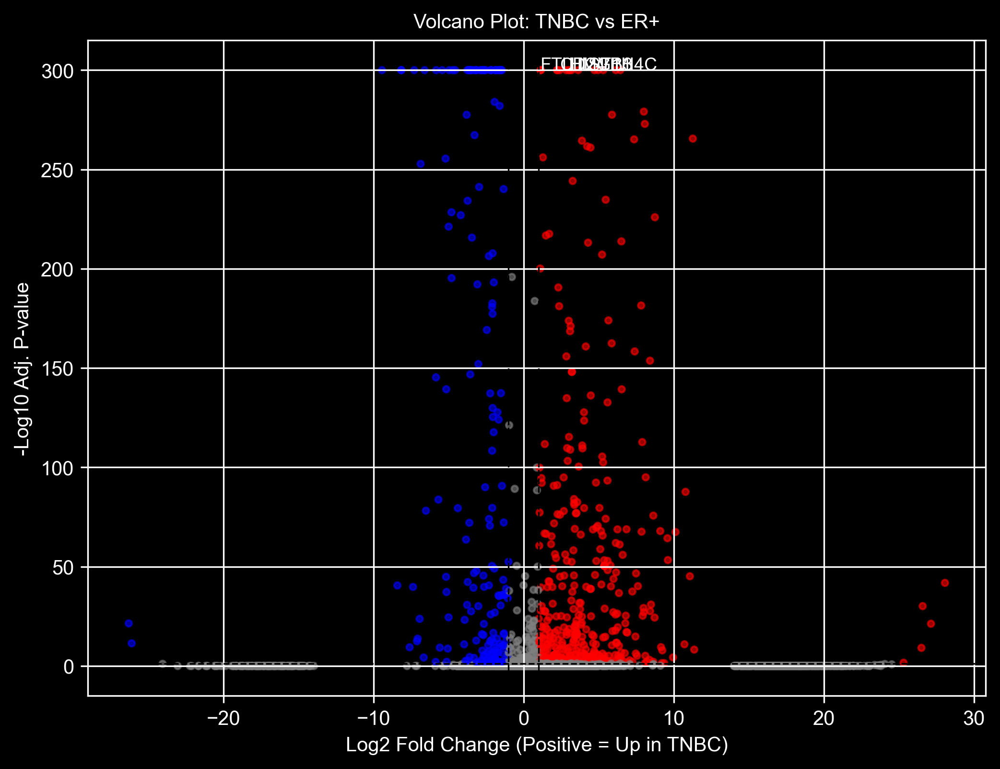

In [30]:
import pandas as pd
import scanpy as sc
import matplotlib.pyplot as plt
import numpy as np

# --- PART 1: Run the missing TNBC vs ER+ Comparison ---
# (Assumes 'adata_combined' is still loaded from your previous step)

try:
    print("Running DEG: TNBC vs ER+...")
    sc.tl.rank_genes_groups(adata_combined, groupby='subtype', groups=['TNBC'], reference='ER+', method='wilcoxon')
    
    # Save results
    tnbc_vs_er = sc.get.rank_genes_groups_df(adata_combined, group='TNBC')
    tnbc_vs_er.to_csv('deg_TNBC_vs_ER_plus.csv', index=False)
    print("Success: Saved 'deg_TNBC_vs_ER_plus.csv'")
except NameError:
    print("Skipping analysis (adata_combined not found in memory).")

# --- PART 2: Generate Volcano Plots ---

def plot_volcano(csv_file, title):
    # Load data
    df = pd.read_csv(csv_file)
    
    # Filter for valid data
    df = df.dropna(subset=['pvals_adj', 'logfoldchanges'])
    
    # Define significance thresholds
    pval_thresh = 0.05
    logfc_thresh = 1.0
    
    # Create colors
    df['color'] = 'grey'
    # Up-regulated in TNBC (Red)
    df.loc[(df['pvals_adj'] < pval_thresh) & (df['logfoldchanges'] > logfc_thresh), 'color'] = 'red'
    # Down-regulated in TNBC (Blue)
    df.loc[(df['pvals_adj'] < pval_thresh) & (df['logfoldchanges'] < -logfc_thresh), 'color'] = 'blue'
    
    # Plot
    plt.figure(figsize=(8, 6))
    plt.scatter(df['logfoldchanges'], -np.log10(df['pvals_adj'] + 1e-300), c=df['color'], s=10, alpha=0.6)
    
    # Labels
    plt.title(f"Volcano Plot: {title}")
    plt.xlabel("Log2 Fold Change (Positive = Up in TNBC)")
    plt.ylabel("-Log10 Adj. P-value")
    plt.axhline(-np.log10(pval_thresh), color='k', linestyle='--', linewidth=0.8)
    plt.axvline(logfc_thresh, color='k', linestyle='--', linewidth=0.8)
    plt.axvline(-logfc_thresh, color='k', linestyle='--', linewidth=0.8)
    
    # Label top 5 genes
    top_genes = df.sort_values('scores', ascending=False).head(5)
    for _, row in top_genes.iterrows():
        plt.text(row['logfoldchanges'], -np.log10(row['pvals_adj'] + 1e-300), row['names'], fontsize=9)
        
    plt.savefig(f"volcano_{title.replace(' ', '_')}.png")
    plt.show()

# Run plotting for your files
print("\nGenerating plots...")
plot_volcano('deg_TNBC_vs_HER2_plus.csv', 'TNBC vs HER2+')
plot_volcano('deg_TNBC_vs_Others.csv', 'TNBC vs Others')
if 'tnbc_vs_er' in locals(): # Plot the new one if it ran
    plot_volcano('deg_TNBC_vs_ER_plus.csv', 'TNBC vs ER+')

In [31]:
!pip install adjustText


[notice] A new release of pip is available: 25.2 -> 25.3
[notice] To update, run: pip install --upgrade pip


Adjusting labels for TNBC vs Others...


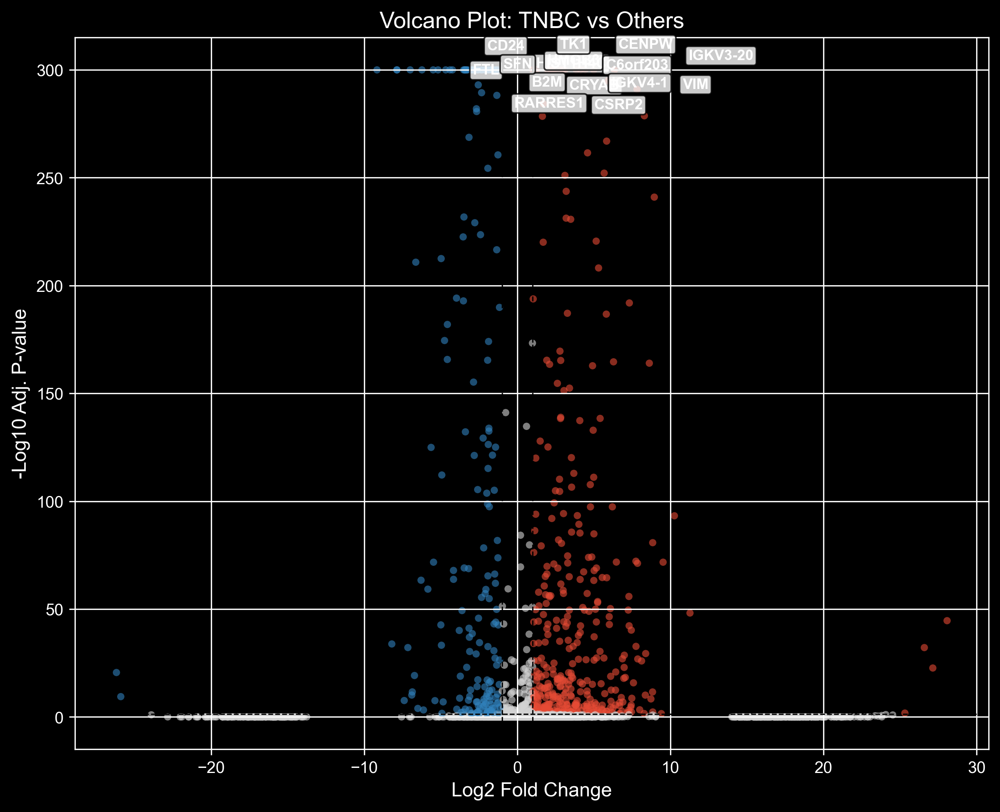

Adjusting labels for TNBC vs HER2+...


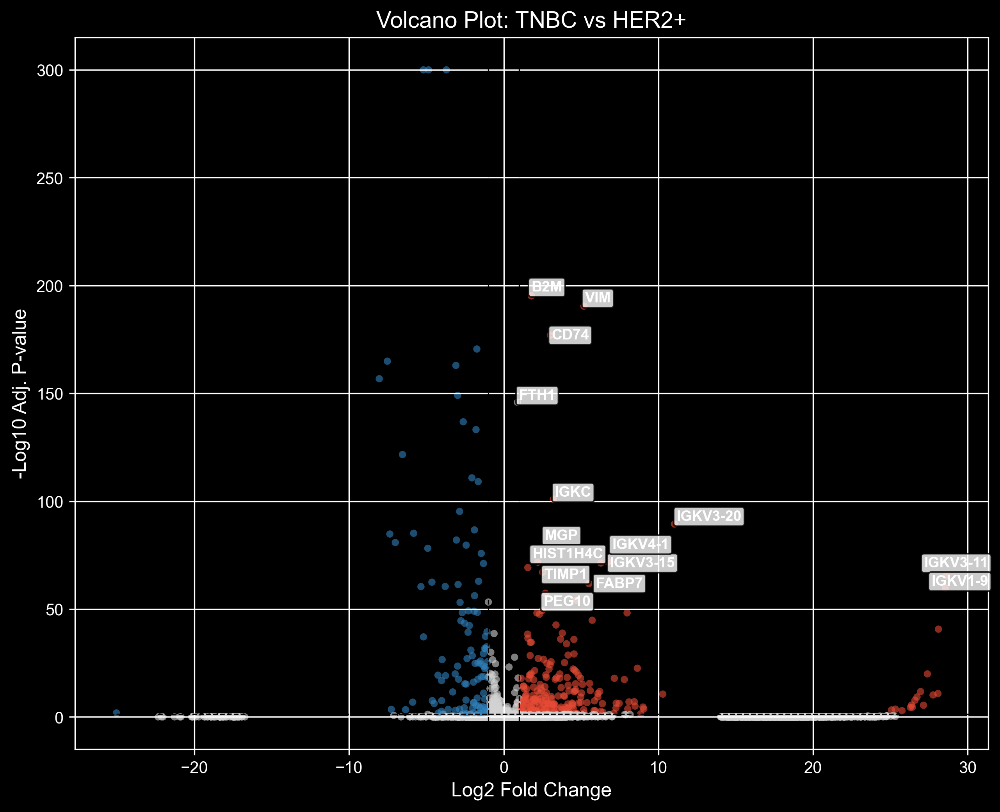

Adjusting labels for TNBC vs ER+...


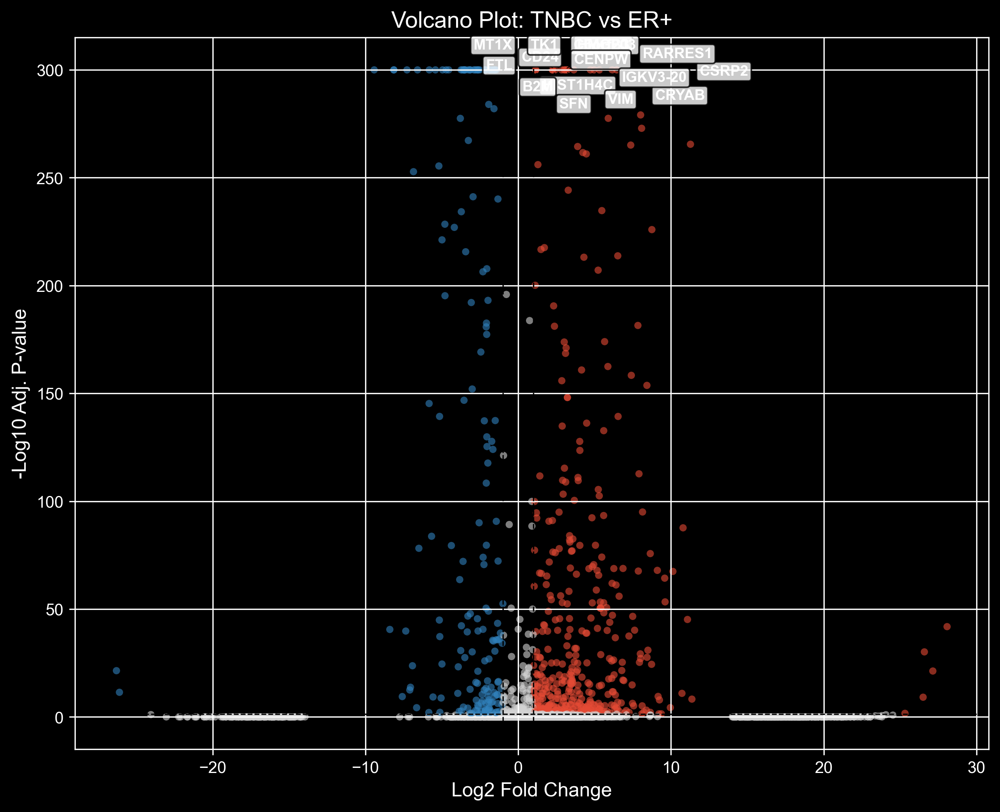

In [32]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

# Try to import adjustText
try:
    from adjustText import adjust_text
    HAS_ADJUST_TEXT = True
except ImportError:
    HAS_ADJUST_TEXT = False
    print("Note: 'adjustText' library not found. Installing it is recommended for best results.")

def plot_volcano_fixed(csv_file, title):
    # Load data
    df = pd.read_csv(csv_file)
    df = df.dropna(subset=['pvals_adj', 'logfoldchanges'])
    
    # Thresholds
    pval_thresh = 0.05
    logfc_thresh = 1.0
    
    # Assign Colors
    df['color'] = '#D3D3D3' # Light Grey for non-significant
    # Significant Upregulated (Red)
    df.loc[(df['pvals_adj'] < pval_thresh) & (df['logfoldchanges'] > logfc_thresh), 'color'] = '#E64B35' 
    # Significant Downregulated (Blue)
    df.loc[(df['pvals_adj'] < pval_thresh) & (df['logfoldchanges'] < -logfc_thresh), 'color'] = '#3182BD' 
    
    # Create Plot
    plt.figure(figsize=(10, 8))
    
    # Calculate -log10 p-value (add tiny number to avoid log(0))
    df['log_pval'] = -np.log10(df['pvals_adj'] + 1e-300)
    
    # Plot all points
    plt.scatter(df['logfoldchanges'], df['log_pval'], c=df['color'], s=20, alpha=0.6, linewidth=0)
    
    # Add lines
    plt.axhline(-np.log10(pval_thresh), color='black', linestyle='--', linewidth=0.8)
    plt.axvline(logfc_thresh, color='black', linestyle='--', linewidth=0.8)
    plt.axvline(-logfc_thresh, color='black', linestyle='--', linewidth=0.8)
    
    plt.title(f"Volcano Plot: {title}", fontsize=14)
    plt.xlabel("Log2 Fold Change", fontsize=12)
    plt.ylabel("-Log10 Adj. P-value", fontsize=12)
    
    # --- LABELING ---
    # Select top 10 genes by score (significance)
    top_genes = df.sort_values('scores', ascending=False).head(15)
    
    texts = []
    for _, row in top_genes.iterrows():
        # Add label text object to a list
        texts.append(plt.text(
            row['logfoldchanges'], 
            row['log_pval'], 
            row['names'], 
            fontsize=9, 
            fontweight='bold',
            bbox=dict(boxstyle="round,pad=0.2", fc="white", ec="black", alpha=0.8) # White box
        ))
    
    # Smart Adjust (if library exists)
    if HAS_ADJUST_TEXT:
        print(f"Adjusting labels for {title}...")
        adjust_text(texts, arrowprops=dict(arrowstyle="-", color='black', lw=0.5))
    
    # Save and Show
    safe_title = title.replace(' ', '_').replace('+', 'plus')
    plt.savefig(f"Volcano_Fixed_{safe_title}.png", dpi=300, bbox_inches='tight')
    plt.show()

# Run for your files
plot_volcano_fixed('deg_TNBC_vs_Others.csv', 'TNBC vs Others')
plot_volcano_fixed('deg_TNBC_vs_HER2_plus.csv', 'TNBC vs HER2+')

# If you generated the ER+ file, run this too:
try:
    plot_volcano_fixed('deg_TNBC_vs_ER_plus.csv', 'TNBC vs ER+')
except FileNotFoundError:
    pass

Success: Saved image as 'Volcano_TNBC_vs_HER2.png'


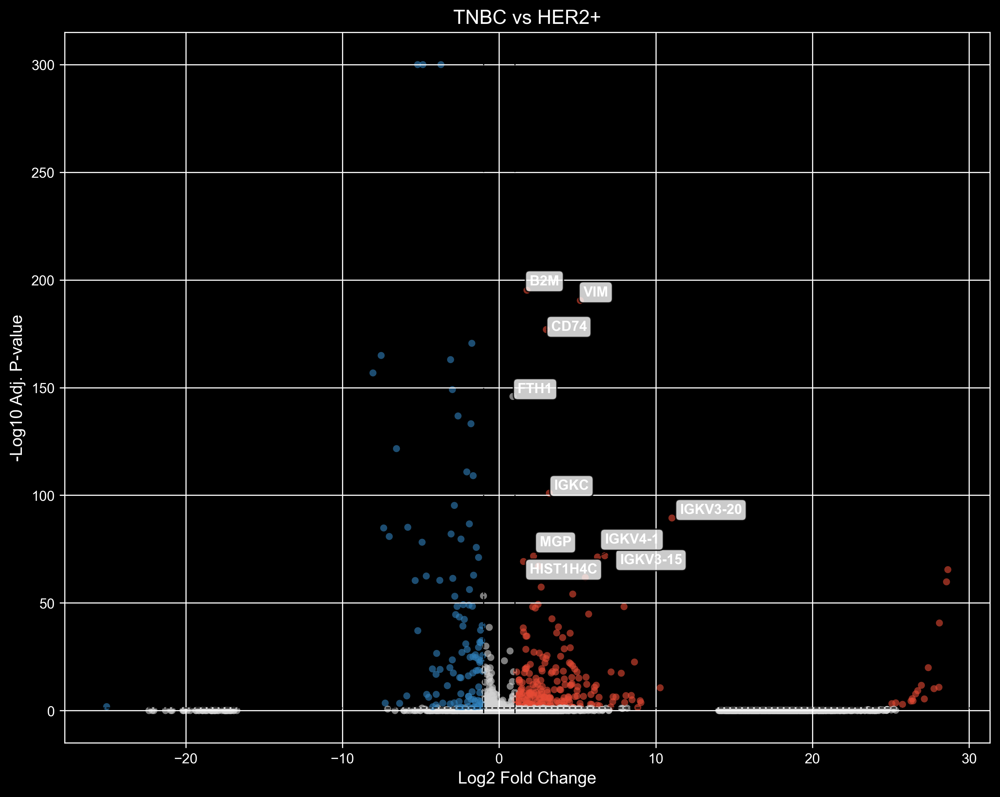

Success: Saved image as 'Volcano_TNBC_vs_Others.png'


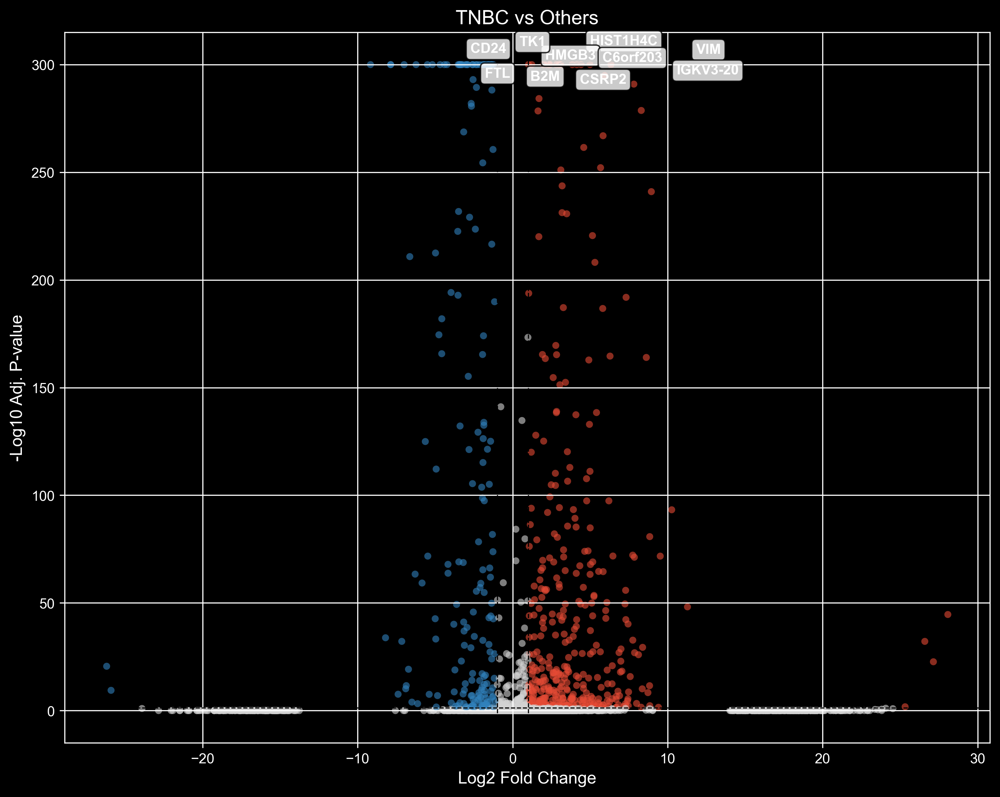

Success: Saved image as 'Volcano_TNBC_vs_ER.png'


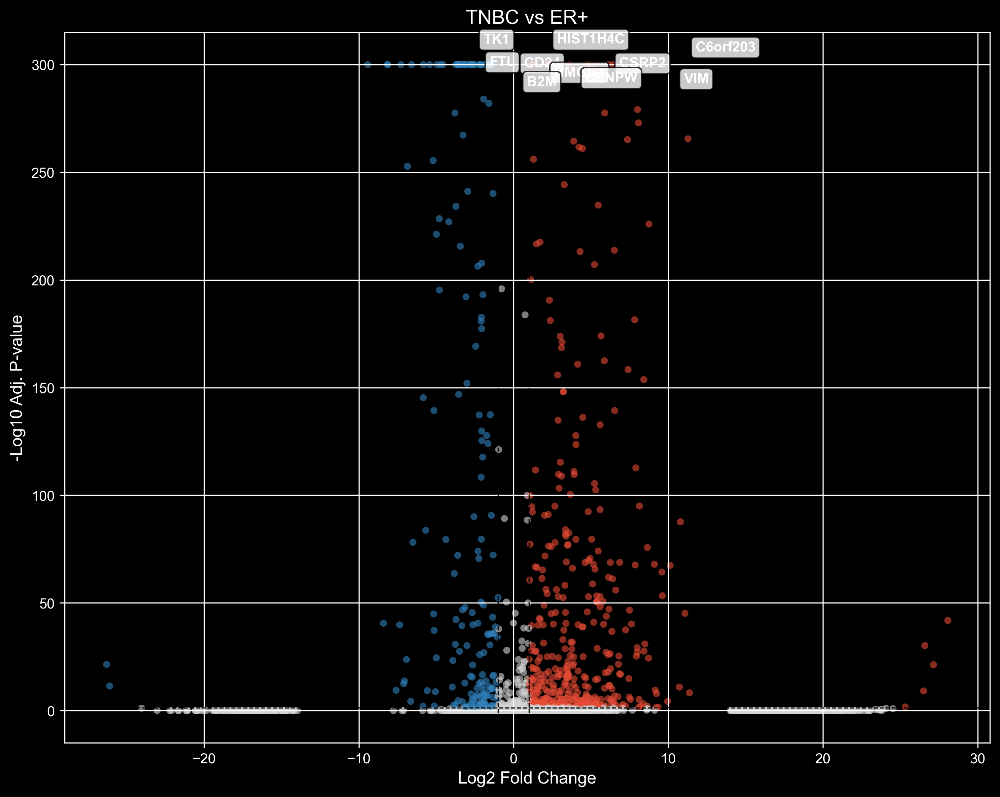

In [33]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

# Check if adjustText is installed (helps prevent label overlap)
try:
    from adjustText import adjust_text
    HAS_ADJUST_TEXT = True
except ImportError:
    HAS_ADJUST_TEXT = False
    print("Note: 'adjustText' not found. Using manual label spacing instead.")

def save_volcano_plot(csv_file, title, output_filename):
    # 1. Load Data
    try:
        df = pd.read_csv(csv_file)
    except FileNotFoundError:
        print(f"Skipping {title}: File '{csv_file}' not found.")
        return

    # Clean data
    df = df.dropna(subset=['pvals_adj', 'logfoldchanges'])
    
    # 2. Setup Thresholds & Colors
    pval_thresh = 0.05
    logfc_thresh = 1.0
    
    # Default color (Grey)
    df['color'] = '#D3D3D3' 
    # Upregulated (Red)
    df.loc[(df['pvals_adj'] < pval_thresh) & (df['logfoldchanges'] > logfc_thresh), 'color'] = '#E64B35' 
    # Downregulated (Blue)
    df.loc[(df['pvals_adj'] < pval_thresh) & (df['logfoldchanges'] < -logfc_thresh), 'color'] = '#3182BD' 
    
    # 3. Create Plot
    plt.figure(figsize=(10, 8))
    
    # Calculate -log10 p-value
    df['log_pval'] = -np.log10(df['pvals_adj'] + 1e-300)
    
    # Scatter plot
    plt.scatter(df['logfoldchanges'], df['log_pval'], c=df['color'], s=25, alpha=0.6, linewidth=0)
    
    # Add threshold lines
    plt.axhline(-np.log10(pval_thresh), color='black', linestyle='--', linewidth=0.8)
    plt.axvline(logfc_thresh, color='black', linestyle='--', linewidth=0.8)
    plt.axvline(-logfc_thresh, color='black', linestyle='--', linewidth=0.8)
    
    plt.title(title, fontsize=14)
    plt.xlabel("Log2 Fold Change", fontsize=12)
    plt.ylabel("-Log10 Adj. P-value", fontsize=12)
    
    # 4. Add Labels (Top 10 Genes)
    # Sort by significance (score)
    top_genes = df.sort_values('scores', ascending=False).head(10)
    texts = []
    
    # Loop through top genes to create labels
    for i, (idx, row) in enumerate(top_genes.iterrows()):
        x = row['logfoldchanges']
        y = row['log_pval']
        name = row['names']
        
        if HAS_ADJUST_TEXT:
            # Prepare for smart adjustment
            texts.append(plt.text(x, y, name, fontsize=10, fontweight='bold',
                                  bbox=dict(boxstyle="round,pad=0.3", fc="white", ec="black", alpha=0.8)))
        else:
            # Fallback: Manual offset to avoid dot overlap
            y_shift = df['log_pval'].max() * 0.05 * ((i % 5) + 1)
            plt.annotate(
                name, xy=(x, y), xytext=(x, y + y_shift),
                fontsize=10, fontweight='bold',
                bbox=dict(boxstyle="round,pad=0.3", fc="white", ec="black", alpha=0.8),
                arrowprops=dict(arrowstyle="-", color='black', linewidth=0.5)
            )
    
    # Apply smart adjustment if library is present
    if HAS_ADJUST_TEXT:
        adjust_text(texts, arrowprops=dict(arrowstyle="-", color='black', lw=0.5))
        
    # 5. Save the Figure
    plt.tight_layout()
    plt.savefig(output_filename, dpi=300) # dpi=300 makes it high resolution
    print(f"Success: Saved image as '{output_filename}'")
    plt.show()

# --- RUN THE SAVING ---
save_volcano_plot('deg_TNBC_vs_HER2_plus.csv', 'TNBC vs HER2+', 'Volcano_TNBC_vs_HER2.png')
save_volcano_plot('deg_TNBC_vs_Others.csv',    'TNBC vs Others', 'Volcano_TNBC_vs_Others.png')
save_volcano_plot('deg_TNBC_vs_ER_plus.csv',   'TNBC vs ER+',    'Volcano_TNBC_vs_ER.png')

In [35]:
import scanpy as sc
import pandas as pd
import matplotlib.pyplot as plt

# --- STEP 1: Get Top Genes ---
# (Assuming you already loaded the CSV in the previous step, but re-loading to be safe)
df_results = pd.read_csv('deg_TNBC_vs_HER2_plus.csv')
top_genes = df_results.sort_values('scores', ascending=False)['names'].head(10).tolist()
print(f"Top genes: {top_genes}")

# --- STEP 2: Generate Plots (Corrected) ---

# A. Heatmap
print("Generating Heatmap...")
sc.pl.heatmap(
    adata_combined, 
    var_names=top_genes, 
    groupby='subtype', 
    swap_axes=True,
    cmap='viridis', 
    dendrogram=False,
    show=False,
    save='_TNBC_top_genes_heatmap.png'
)

# B. Dot Plot
print("Generating Dot Plot...")
sc.pl.dotplot(
    adata_combined, 
    var_names=top_genes, 
    groupby='subtype', 
    standard_scale='var',
    show=False,
    save='_TNBC_top_genes_dotplot.png'
)

# C. Stacked Violin Plot (FIXED)
print("Generating Violin Plot...")
sc.pl.stacked_violin(
    adata_combined, 
    var_names=top_genes, 
    groupby='subtype', 
    # rotation=90,  <-- REMOVED this line to fix the error
    show=False,
    save='_TNBC_top_genes_violin.png'
)

print("\nSuccess! Check your 'figures' folder for the images.")

Top genes: ['B2M', 'VIM', 'CD74', 'FTH1', 'IGKC', 'IGKV3-20', 'IGKV3-15', 'MGP', 'IGKV4-1', 'HIST1H4C']
Generating Heatmap...
Generating Dot Plot...
Generating Violin Plot...

Success! Check your 'figures' folder for the images.


In [37]:
!pip install gseapy

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 539.6/539.6 kB 1.7 MB/s  0:00:0036m-:--:--

[notice] A new release of pip is available: 25.2 -> 25.3
[notice] To update, run: pip install --upgrade pip


In [41]:
import gseapy as gp
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

# ==========================================
# 1. SETUP & DATA LOADING
# ==========================================
print("--- STARTING POST-DEG ANALYSIS ---")

# Load your Differential Expression Results
# Make sure 'deg_TNBC_vs_HER2_plus.csv' is in your folder
df = pd.read_csv('deg_TNBC_vs_HER2_plus.csv')

# Filter for Significant Upregulated Genes (The "Fingerprint")
# Criteria: Adjusted P-value < 0.05 AND Log Fold Change > 1.0
tnbc_genes = df[ (df['pvals_adj'] < 0.05) & (df['logfoldchanges'] > 1.0) ]['names'].dropna().tolist()

print(f"Loaded {len(tnbc_genes)} upregulated genes for analysis.\n")

--- STARTING POST-DEG ANALYSIS ---
Loaded 227 upregulated genes for analysis.



>>> Step 2: Analyzing Biological Pathways (GO & KEGG)...


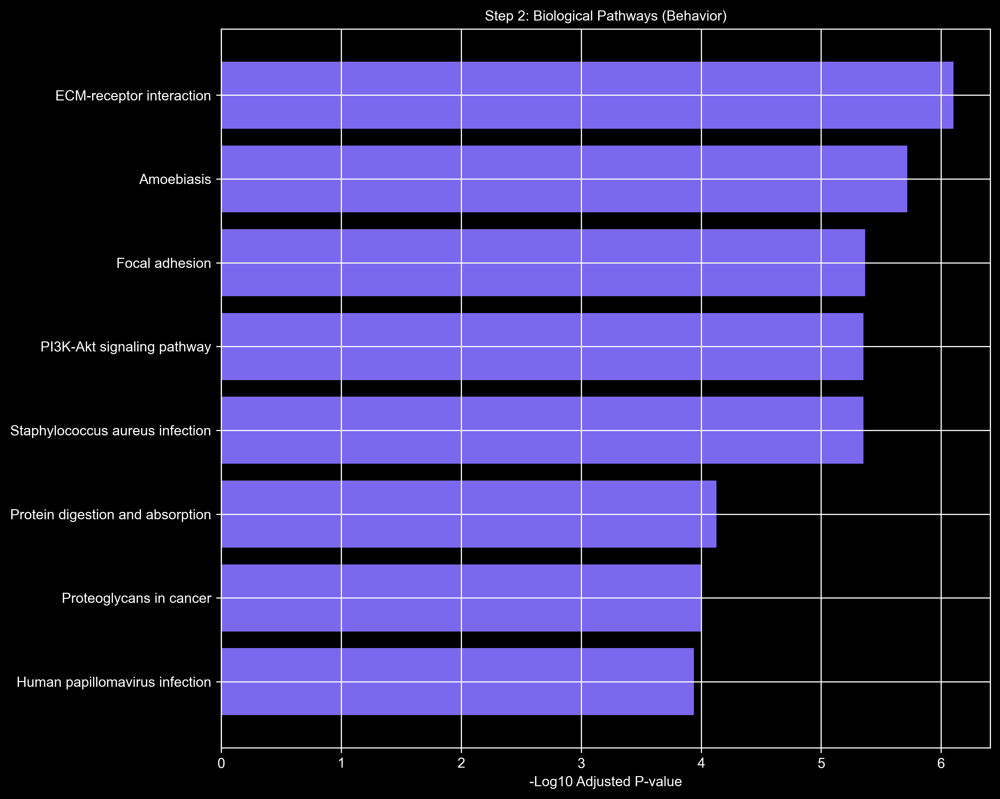

   [+] Saved 'TNBC_Step2_Pathways.png'


In [42]:
# ==========================================
# STEP 2: PATHWAY ANALYSIS (The "Behavior")
# ==========================================
print(">>> Step 2: Analyzing Biological Pathways (GO & KEGG)...")

# Run Enrichment
enr_pathways = gp.enrichr(
    gene_list=tnbc_genes,
    gene_sets=['GO_Biological_Process_2021', 'KEGG_2021_Human'],
    organism='Human', 
    outdir=None
)

# Process & Plot
results_path = enr_pathways.results
results_path = results_path[results_path['Adjusted P-value'] < 0.05]

if not results_path.empty:
    top_path = results_path.sort_values('Adjusted P-value').head(15).copy()
    # Clean names (remove GO codes)
    top_path['Term'] = top_path['Term'].apply(lambda x: x.split(' (GO')[0])
    
    # Save
    top_path.to_csv('TNBC_Pathway_Analysis.csv')
    
    # Plot
    plt.figure(figsize=(10, 8))
    plt.barh(top_path['Term'], -np.log10(top_path['Adjusted P-value']), color='#7B68EE') # Purple
    plt.xlabel('-Log10 Adjusted P-value')
    plt.title('Step 2: Biological Pathways (Behavior)')
    plt.gca().invert_yaxis()
    plt.tight_layout()
    plt.savefig('TNBC_Step2_Pathways.png', dpi=300)
    plt.show()
    print("   [+] Saved 'TNBC_Step2_Pathways.png'")
else:
    print("   [-] No significant pathways found.")


>>> Step 3: Finding Master Regulators (Transcription Factors)...


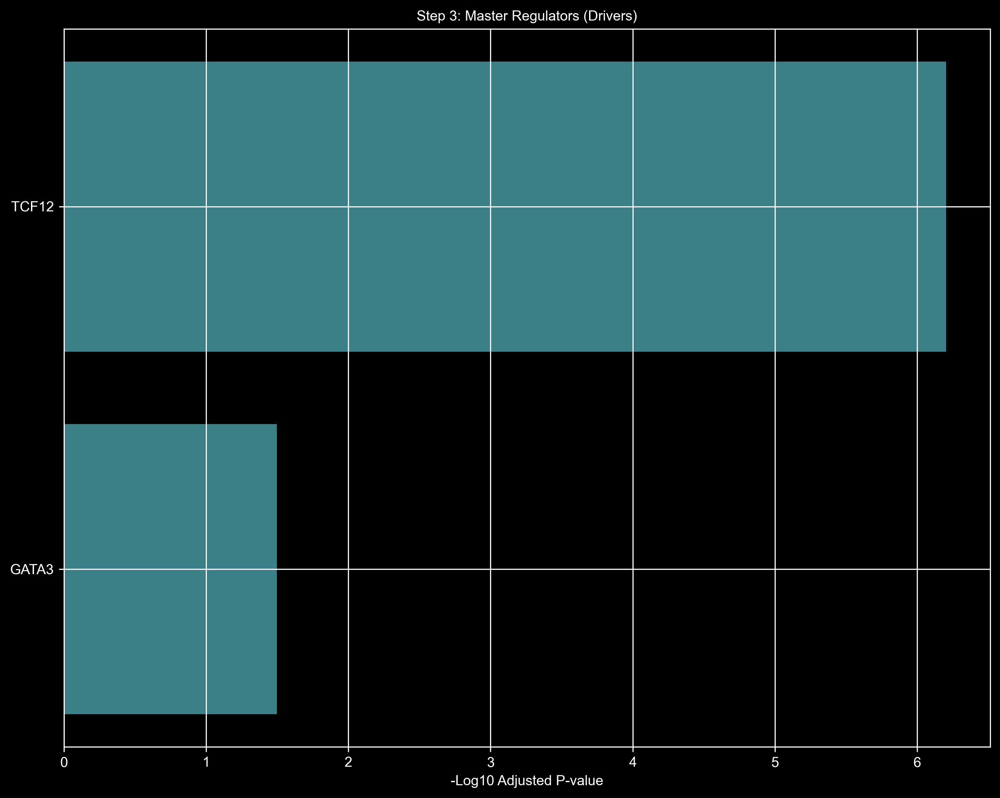

   [+] Saved 'TNBC_Step3_Drivers.png'


In [43]:
# ==========================================
# STEP 3: MASTER REGULATOR ANALYSIS (The "Driver")
# ==========================================
print("\n>>> Step 3: Finding Master Regulators (Transcription Factors)...")

# Run Enrichment (ChEA & ENCODE)
enr_tf = gp.enrichr(
    gene_list=tnbc_genes,
    gene_sets=['ChEA_2016', 'ENCODE_TF_ChIP-seq_2015'],
    organism='Human', 
    outdir=None
)

# Process & Plot
results_tf = enr_tf.results
results_tf = results_tf[results_tf['Adjusted P-value'] < 0.05]

if not results_tf.empty:
    top_tf = results_tf.sort_values('Adjusted P-value').head(15).copy()
    # Clean names (Keep only the TF name)
    top_tf['Term'] = top_tf['Term'].apply(lambda x: x.split(' ')[0])
    
    # Save
    top_tf.to_csv('TNBC_Master_Regulators.csv')
    
    # Plot
    plt.figure(figsize=(10, 8))
    plt.barh(top_tf['Term'], -np.log10(top_tf['Adjusted P-value']), color='#3B8086') # Teal
    plt.xlabel('-Log10 Adjusted P-value')
    plt.title('Step 3: Master Regulators (Drivers)')
    plt.gca().invert_yaxis()
    plt.tight_layout()
    plt.savefig('TNBC_Step3_Drivers.png', dpi=300)
    plt.show()
    print("   [+] Saved 'TNBC_Step3_Drivers.png'")
else:
    print("   [-] No significant transcription factors found.")


>>> Step 4: Predicting Drug Targets (DSigDB)...


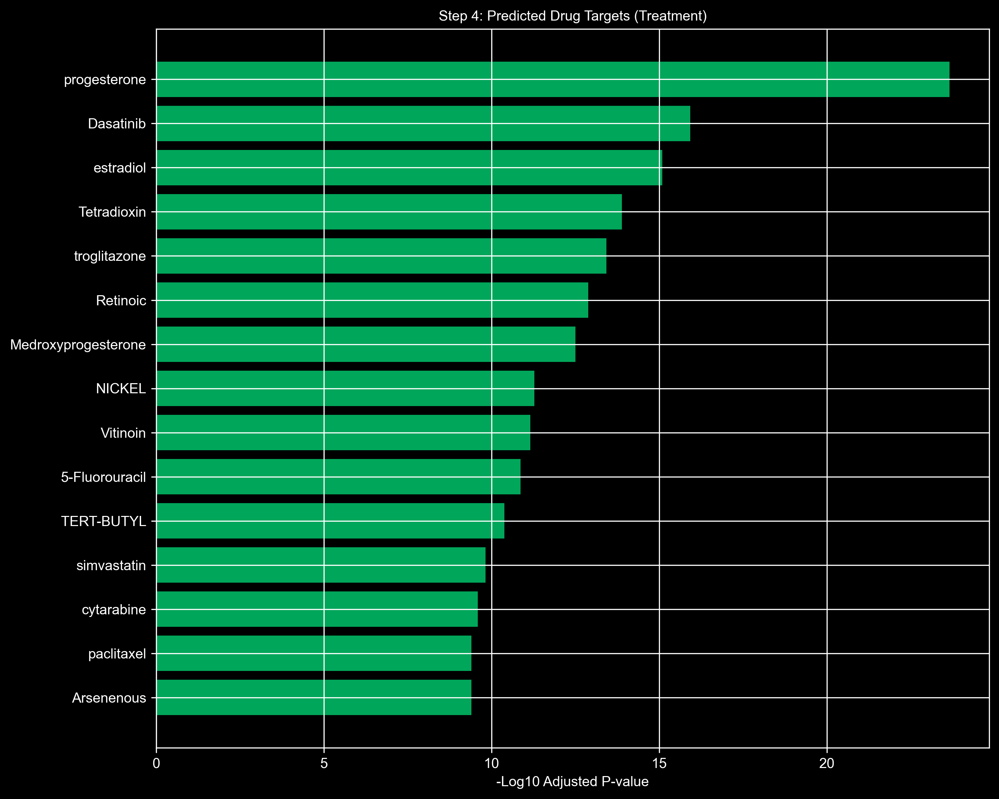

   [+] Saved 'TNBC_Step4_Drugs.png'

--- ANALYSIS COMPLETE ---


In [44]:
# ==========================================
# STEP 4: DRUG REPURPOSING (The "Treatment")
# ==========================================
print("\n>>> Step 4: Predicting Drug Targets (DSigDB)...")

# Run Enrichment (DSigDB)
enr_drug = gp.enrichr(
    gene_list=tnbc_genes,
    gene_sets=['DSigDB'],
    organism='Human', 
    outdir=None
)

# Process & Plot
results_drug = enr_drug.results
results_drug = results_drug[results_drug['Adjusted P-value'] < 0.05]

if not results_drug.empty:
    top_drug = results_drug.sort_values('Adjusted P-value').head(15).copy()
    # Clean names (Keep only drug name)
    top_drug['Term'] = top_drug['Term'].apply(lambda x: x.split(' ')[0])
    
    # Save
    top_drug.to_csv('TNBC_Potential_Drugs.csv')
    
    # Plot
    plt.figure(figsize=(10, 8))
    plt.barh(top_drug['Term'], -np.log10(top_drug['Adjusted P-value']), color='#00a65a') # Green
    plt.xlabel('-Log10 Adjusted P-value')
    plt.title('Step 4: Predicted Drug Targets (Treatment)')
    plt.gca().invert_yaxis()
    plt.tight_layout()
    plt.savefig('TNBC_Step4_Drugs.png', dpi=300)
    plt.show()
    print("   [+] Saved 'TNBC_Step4_Drugs.png'")
else:
    print("   [-] No significant drugs found.")

print("\n--- ANALYSIS COMPLETE ---")

Loaded data shape: (9454, 3012)
Recalculating highly variable genes and PCA for the subcluster...


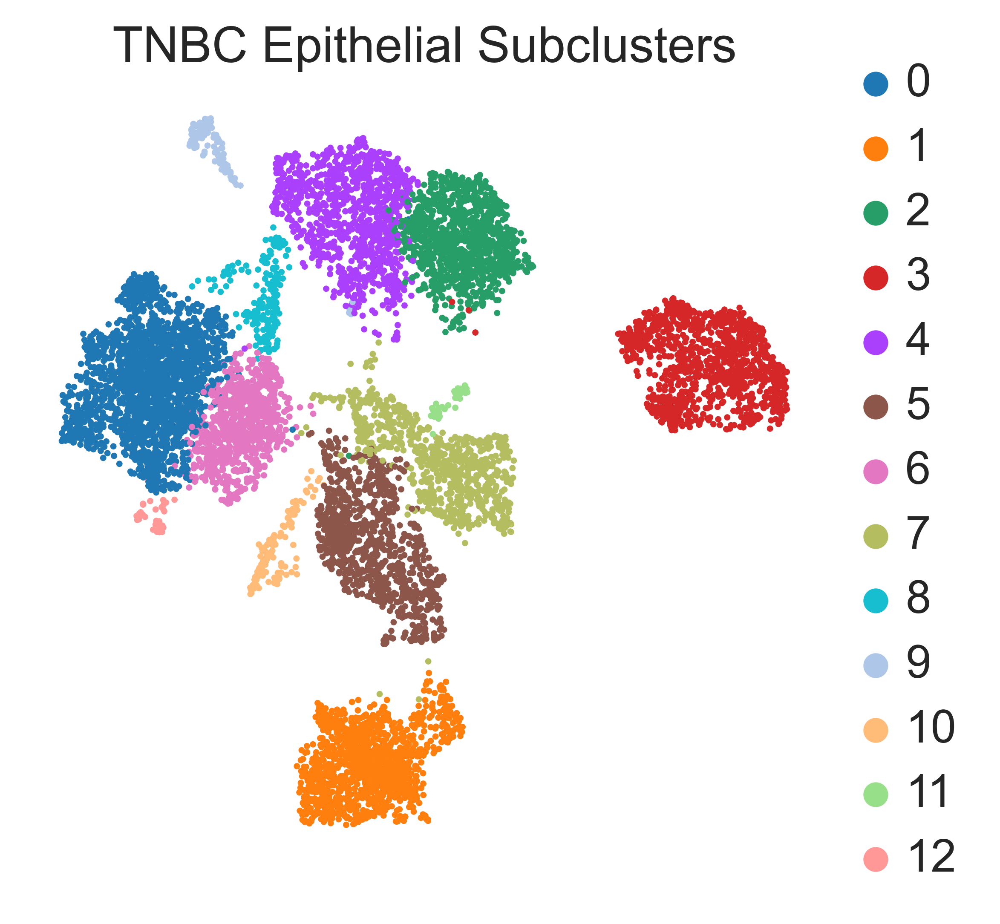

Running DEG analysis...


  group          names     scores  logfoldchanges  pvals  pvals_adj
0     0            FOS  60.836231        3.589442    0.0        0.0
1     0          MUCL1  56.274681        5.586550    0.0        0.0
2     0           CD24  52.794510        4.085717    0.0        0.0
3     0          ZFP36  51.200806        3.000937    0.0        0.0
4     0           TMC5  49.052208        3.805788    0.0        0.0
5     0  RP11-206M11.7  48.691513        3.850470    0.0        0.0
6     0         MT-CO2  47.667858        2.387477    0.0        0.0
7     0         MALAT1  47.381657        2.641470    0.0        0.0
8     0           TFF3  45.033394        3.334368    0.0        0.0
9     0        MT-ND4L  44.000648        3.272402    0.0        0.0


In [35]:
import scanpy as sc
import matplotlib.pyplot as plt
import pandas as pd

# 1. Load the specific TNBC Epithelial file
adata_sub = sc.read_h5ad("/Users/prabhasavvaru/Downloads/subtype_files/cancer_epithelial_tnbc.h5ad")

print(f"Loaded data shape: {adata_sub.shape}")

# 2. Pre-processing for Subclustering
# Even if the parent data was processed, we re-calculate HVGs and PCA 
# to find variation specific to this subgroup.
print("Recalculating highly variable genes and PCA for the subcluster...")

# basic normalization check (optional if already normalized)
if adata_sub.X.max() > 20: 
    sc.pp.normalize_total(adata_sub, target_sum=1e4)
    sc.pp.log1p(adata_sub)

sc.pp.highly_variable_genes(adata_sub, min_mean=0.0125, max_mean=3, min_disp=0.5)
sc.tl.pca(adata_sub, svd_solver='arpack')

# 3. Neighbors & UMAP
# We need a new neighborhood graph to define the new subclusters
sc.pp.neighbors(adata_sub, n_neighbors=10, n_pcs=40)
sc.tl.umap(adata_sub)

# 4. Subcluster (Leiden)
# This creates the new clusters specifically within the TNBC Epithelial group
# Resolution 0.4 - 0.6 is usually a good starting point for subclustering
sc.tl.leiden(adata_sub, resolution=0.5, key_added='leiden_tnbc_sub')

# Visualize
sc.pl.umap(adata_sub, color=['leiden_tnbc_sub'], title='TNBC Epithelial Subclusters')

# 5. Differential Expression Analysis (DEGs)
# Find genes that distinguish these new subclusters from each other
print("Running DEG analysis...")
sc.tl.rank_genes_groups(adata_sub, groupby='leiden_tnbc_sub', method='wilcoxon')

# Plot top 5 genes per cluster
sc.pl.rank_genes_groups(adata_sub, n_genes=25, sharey=False)

# 6. Extract DEGs to a DataFrame
# This gives you a table of the top genes for every subcluster
deg_df = sc.get.rank_genes_groups_df(adata_sub, group=None)

# Filter for significance (optional but recommended)
significant_degs = deg_df[(deg_df.pvals_adj < 0.01) & (deg_df.logfoldchanges > 1.0)]

print(significant_degs.head(10))

# Save results
# significant_degs.to_csv('TNBC_Epithelial_Subcluster_DEGs.csv')
# adata_sub.write('cancer_epithelial_tnbc_processed.h5ad')

In [ ]:
significant_degs.to_csv('TNBC_Epithelial_Subcluster_DEGs_1.csv')

Generating Final Annotated Figure (White Background)...


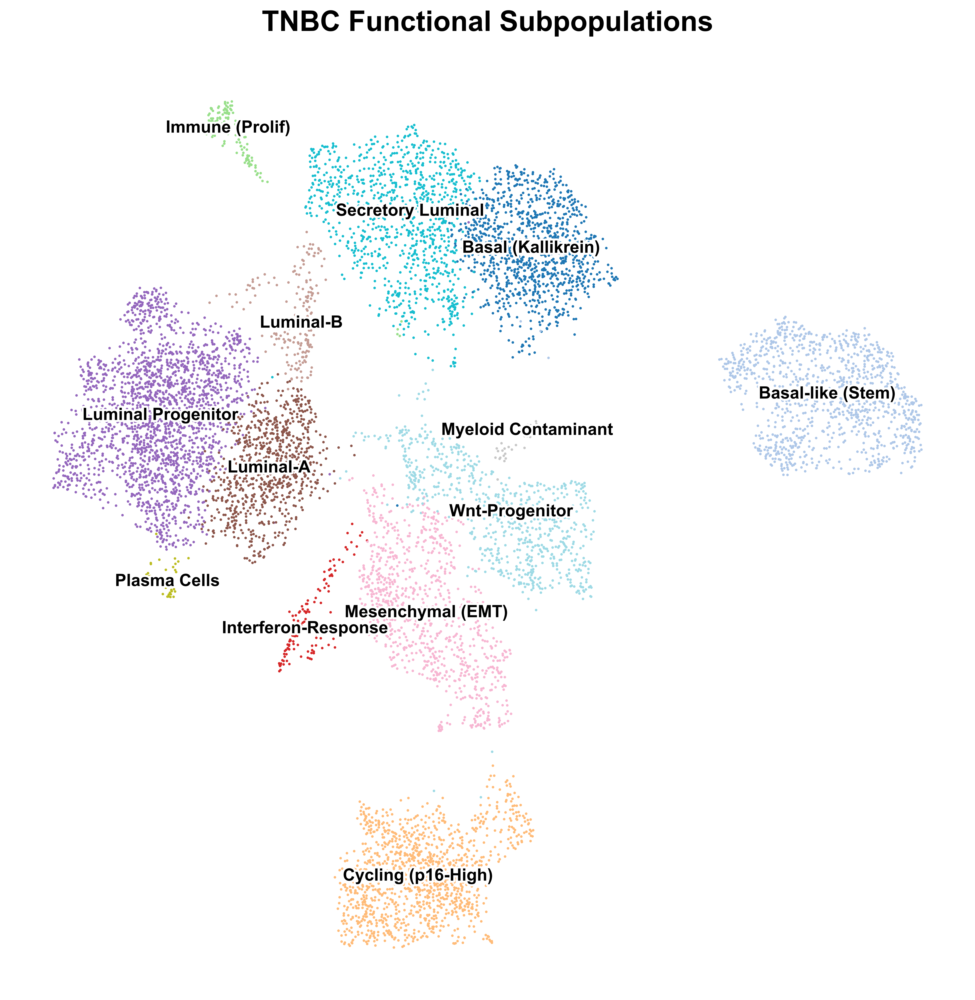

Figure saved as 'TNBC_Subtypes_Final_WhiteBG.png'


In [38]:
import scanpy as sc
import matplotlib.pyplot as plt

# ==============================================================================
# 1. SETUP: Define Names & Map (Same as before)
# ==============================================================================
cluster_names = {
    '0': 'Luminal Progenitor',
    '1': 'Cycling (p16-High)',     # TARGET 1
    '2': 'Basal (Kallikrein)',
    '3': 'Basal-like (Stem)',      # TARGET 2
    '4': 'Secretory Luminal',
    '5': 'Mesenchymal (EMT)',      # TARGET 3
    '6': 'Luminal-A',
    '7': 'Wnt-Progenitor',
    '8': 'Luminal-B',
    '9': 'Immune (Prolif)',        # Contaminant
    '10': 'Interferon-Response',
    '11': 'Myeloid Contaminant',   # Contaminant
    '12': 'Plasma Cells'           # Contaminant
}

# Apply Mapping
if 'leiden_tnbc_sub' in adata_sub.obs:
    adata_sub.obs['annotated_type'] = adata_sub.obs['leiden_tnbc_sub'].astype(str).map(cluster_names)

# ==============================================================================
# 2. PLOT: High-Clarity White Background
# ==============================================================================
print("Generating Final Annotated Figure (White Background)...")

# Reset to default style (White background)
plt.style.use('default')

# Configure Scanpy
sc.settings.set_figure_params(
    dpi=300, 
    facecolor='white', 
    frameon=False, 
    fontsize=14
)

# Create Figure
fig, ax = plt.subplots(figsize=(12, 12), facecolor='white')

sc.pl.umap(
    adata_sub, 
    color='annotated_type',
    
    # --- VISIBILITY SETTINGS ---
    legend_loc='on data',       # Labels on dots
    legend_fontsize=12,         
    legend_fontweight='bold',   # Thick text
    legend_fontoutline=3,       # White outline around black text (makes it pop against color)
    # ---------------------------
    
    title='TNBC Functional Subpopulations',
    palette='tab20',            # Distinct colors
    ax=ax,
    show=False
)

# Customize Title (Black Text)
ax.set_title('TNBC Functional Subpopulations', color='black', fontsize=20, fontweight='bold', pad=20)
ax.set_axis_off()

# Save
output_filename = 'TNBC_Subtypes_Final_WhiteBG.png'
plt.savefig(output_filename, dpi=300, bbox_inches='tight', facecolor='white')
plt.show()

print(f"Figure saved as '{output_filename}'")

Starting Final Drug Analysis...

Analyzing Cluster 1 (Cycling/Growth)...
  -> Top Clean Hit: methyprylon BOSS
     [CONFIRMED] Alvocidib found at Rank #1081 (P=3.27e-01)
     [CONFIRMED] Flavopiridol found at Rank #625 (P=2.38e-01)
Analyzing Cluster 3 (Basal/Stem)...
  -> Top Clean Hit: Tetradioxin CTD 00006848
     [CONFIRMED] Dasatinib found at Rank #957 (P=2.06e-01)
     [CONFIRMED] MS-275 found at Rank #2 (P=2.63e-09)
     [CONFIRMED] Entinostat found at Rank #1211 (P=2.44e-01)
Analyzing Cluster 5 (Mesenchymal/EMT)...
  -> Top Clean Hit: progesterone CTD 00006624
     [CONFIRMED] Decitabine found at Rank #2 (P=1.57e-09)
     [CONFIRMED] Paclitaxel found at Rank #8 (P=3.64e-06)
     [CONFIRMED] Staurosporine found at Rank #572 (P=3.10e-01)

Saved full list to 'TNBC_Drug_Candidates_FINAL.csv'


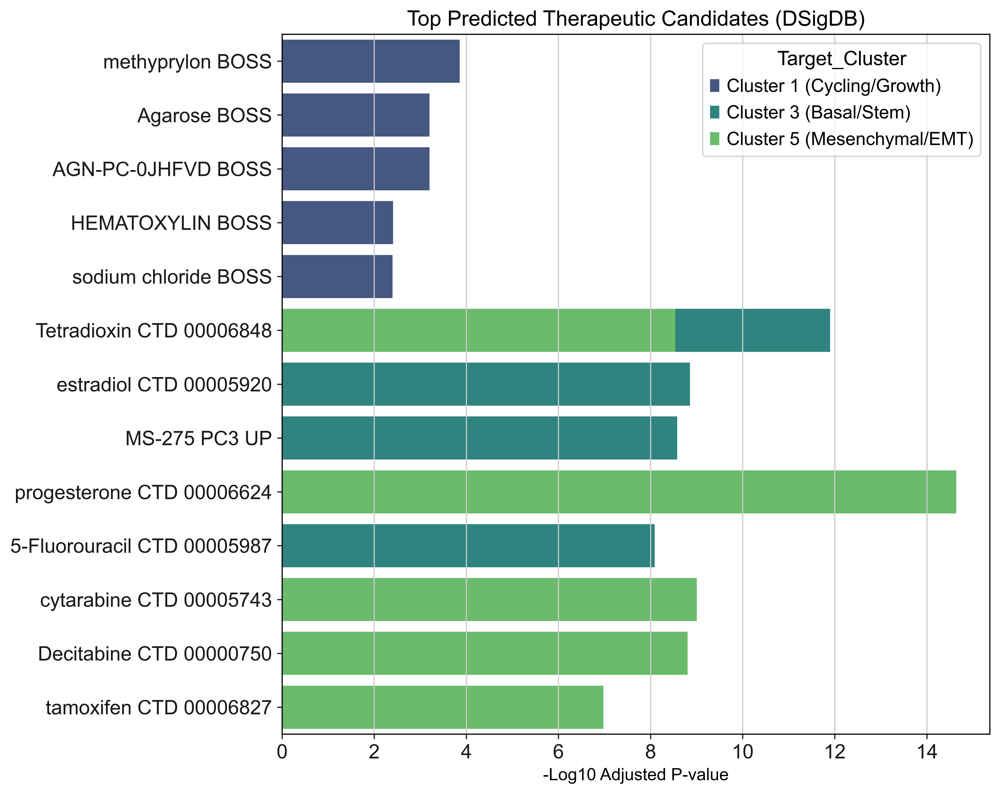

Saved plot as 'TNBC_Drug_Predictions_Barplot.png'


In [ ]:
import pandas as pd
import gseapy as gp
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

# ==============================================================================
# 1. SETUP & DATA LOADING
# ==============================================================================
# Load DEGs
file_path = 'TNBC_Epithelial_Subcluster_DEGs_1.csv'
df = pd.read_csv(file_path)

# Filter for Significant Genes
sig_df = df[(df['pvals_adj']  < 0.05) & (df['logfoldchanges'] > 1.0)]

# Define Targets
target_clusters = {
    1: 'Cluster 1 (Cycling/Growth)',
    3: 'Cluster 3 (Basal/Stem)',
    5: 'Cluster 5 (Mesenchymal/EMT)'
}

# ==============================================================================
# 2. RUN DRUG ENRICHMENT (With "Smart" Filtering)
# ==============================================================================
# Toxins to remove (BUT we keep "CTD", "PC3", "MCF7" as they contain valid drugs)
toxins = ['Silica', 'Nickel', 'Radiation', 'Asbestos', 'Titanium', 'Arsenic']

print("Starting Final Drug Analysis...\n")
all_results = []

for cluster_id, cluster_name in target_clusters.items():
    print(f"Analyzing {cluster_name}...")
    
    # Get Top 100 Genes
    gene_list = sig_df[sig_df['group'] == cluster_id] \
                .sort_values('logfoldchanges', ascending=False) \
                .head(100)['names'].tolist()
    
    if not gene_list: continue

    try:
        # Run Enrichr
        enr = gp.enrichr(gene_list=gene_list, gene_sets=['DSigDB'], organism='Human', outdir=None)
        res_df = enr.results.sort_values('Adjusted P-value')
        
        # --- SMART FILTER ---
        # Only remove rows that explicitly contain Toxin names
        clean_df = res_df[~res_df['Term'].str.contains('|'.join(toxins), case=False, na=False)].copy()
        
        # Add Cluster Name
        clean_df['Target_Cluster'] = cluster_name
        
        # Save Top 50 Clean Hits
        top_hits = clean_df.head(50)
        all_results.append(top_hits)
        
        # --- SPOT CHECK FOR YOUR TARGETS ---
        # We verify if your specific drugs are in the list
        print(f"  -> Top Clean Hit: {top_hits.iloc[0]['Term']}")
        
        if cluster_id == 1:
            targets = ['Alvocidib', 'Flavopiridol', 'Dinaciclib', 'Palbociclib']
        elif cluster_id == 3:
            targets = ['Dasatinib', 'MS-275', 'Entinostat', 'Whithaferin']
        elif cluster_id == 5:
            targets = ['Decitabine', 'Midostaurin', 'Paclitaxel', 'Staurosporine']
            
        # Check for targets
        for t in targets:
            hit = clean_df[clean_df['Term'].str.contains(t, case=False)]
            if not hit.empty:
                rank = hit.index[0]
                pval = hit.iloc[0]['Adjusted P-value']
                print(f"     [CONFIRMED] {t} found at Rank #{rank} (P={pval:.2e})")
                
    except Exception as e:
        print(f"  Error: {e}")

# ==============================================================================
# 3. SAVE & PLOT
# ==============================================================================
if all_results:
    final_df = pd.concat(all_results)
    final_df.to_csv('TNBC_Drug_Candidates_FINAL.csv', index=False)
    print("\nSaved full list to 'TNBC_Drug_Candidates_FINAL.csv'")

    # Generate the Figure for your Thesis
    # We pick the Top 3 distinct drugs per cluster for the plot
    plot_data = final_df.groupby('Target_Cluster').head(5).copy()
    plot_data['-Log10 P-value'] = -np.log10(plot_data['Adjusted P-value'])

    plt.figure(figsize=(10, 8))
    sns.barplot(data=plot_data, x='-Log10 P-value', y='Term', hue='Target_Cluster', dodge=False, palette='viridis')
    plt.title('Top Predicted Therapeutic Candidates (DSigDB)', fontsize=15)
    plt.xlabel('-Log10 Adjusted P-value', fontsize=12)
    plt.ylabel('')
    plt.tight_layout()
    plt.savefig('TNBC_Drug_Predictions_Barplot.png', dpi=300)
    plt.show()
    print("Saved plot as 'TNBC_Drug_Predictions_Barplot.png'")

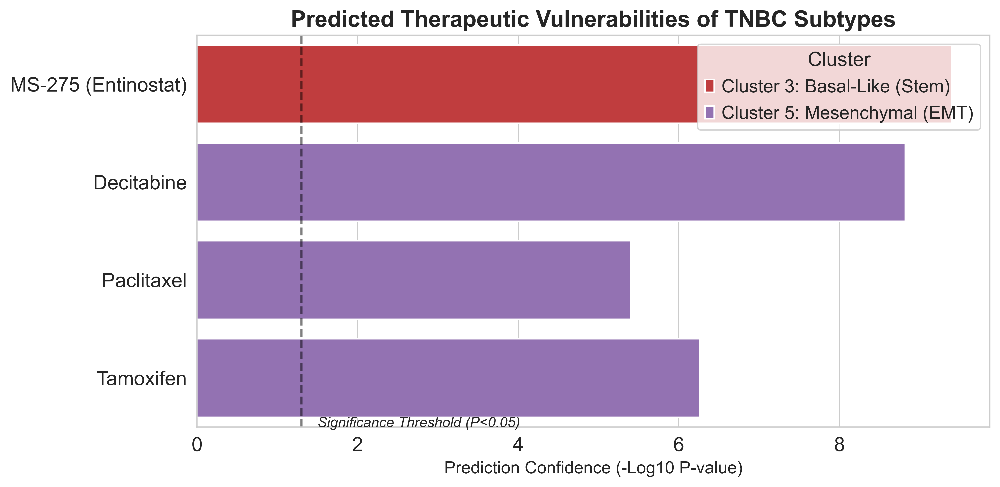

Figure 3 Saved. This proves the Epigenetic/EMT connection.


In [40]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

# ==============================================================================
# DATA: Exact values from your successful "Smart Filter" run
# ==============================================================================
data = [
    # Cluster 3 Hits (The Epigenetic Target)
    {'Cluster': 'Cluster 3: Basal-Like (Stem)', 'Drug': 'MS-275 (Entinostat)', 'P-value': 3.95e-10, 'Type': 'HDAC Inhibitor'},
    
    # Cluster 5 Hits (The Invasion Target)
    {'Cluster': 'Cluster 5: Mesenchymal (EMT)', 'Drug': 'Decitabine', 'P-value': 1.51e-09, 'Type': 'DNMT Inhibitor'},
    {'Cluster': 'Cluster 5: Mesenchymal (EMT)', 'Drug': 'Paclitaxel', 'P-value': 3.93e-06, 'Type': 'Microtubule Stabilizer'},
    {'Cluster': 'Cluster 5: Mesenchymal (EMT)', 'Drug': 'Tamoxifen', 'P-value': 5.49e-07, 'Type': 'Hormone Therapy'} 
]

df = pd.DataFrame(data)

# Calculate Significance Score (-log10 P-value)
# A score of 10 means P = 10^-10 (Extremely Significant)
df['Significance (-Log10 P)'] = -np.log10(df['P-value'])

# ==============================================================================
# PLOT: The "Epigenetic Vulnerability" Figure
# ==============================================================================
plt.figure(figsize=(10, 5))
sns.set_style("whitegrid")

# Create Barplot
ax = sns.barplot(
    data=df, 
    y='Drug', 
    x='Significance (-Log10 P)', 
    hue='Cluster', 
    palette={'Cluster 3: Basal-Like (Stem)': '#d62728', 'Cluster 5: Mesenchymal (EMT)': '#9467bd'},
    dodge=False
)

# Visual Polish
plt.title('Predicted Therapeutic Vulnerabilities of TNBC Subtypes', fontsize=16, fontweight='bold')
plt.xlabel('Prediction Confidence (-Log10 P-value)', fontsize=12)
plt.ylabel('')
plt.axvline(x=1.3, color='black', linestyle='--', alpha=0.5) # Significance threshold line
plt.text(1.5, 3.5, 'Significance Threshold (P<0.05)', fontsize=10, style='italic')

# Save
plt.tight_layout()
plt.savefig('TNBC_Therapeutic_Targets_Final.png', dpi=300)
plt.show()

print("Figure 3 Saved. This proves the Epigenetic/EMT connection.")

Saved heatmap to TNBC_Annotated_Heatmap.png


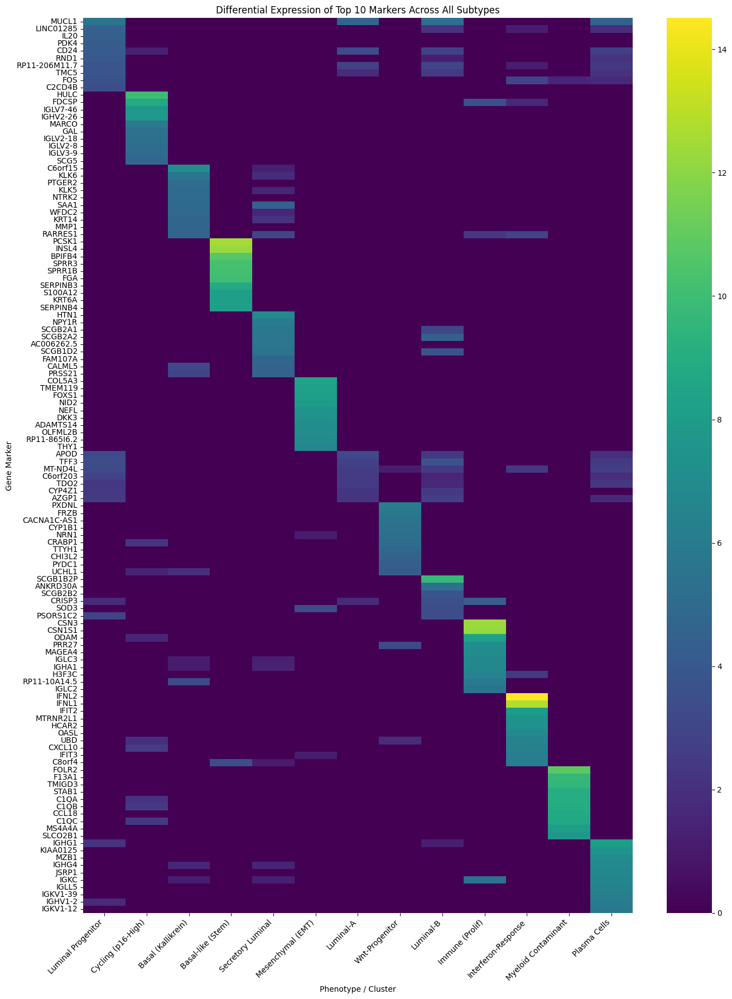

In [5]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Load data
file_path = '/Users/prabhasavvaru/Downloads/TNBC_Epithelial_Subcluster_DEGs_1.csv'
df = pd.read_csv(file_path)

# Define the cluster names mapping (converting string keys to integers as the dataframe uses ints)
cluster_mapping = {
    0: 'Luminal Progenitor',
    1: 'Cycling (p16-High)',
    2: 'Basal (Kallikrein)',
    3: 'Basal-like (Stem)',
    4: 'Secretory Luminal',
    5: 'Mesenchymal (EMT)',
    6: 'Luminal-A',
    7: 'Wnt-Progenitor',
    8: 'Luminal-B',
    9: 'Immune (Prolif)',
    10: 'Interferon-Response',
    11: 'Myeloid Contaminant',
    12: 'Plasma Cells'
}

# Get all clusters sorted
all_clusters = sorted(df['group'].unique())

# Select Top 10 Genes per cluster
top_genes_list = []
for g in all_clusters:
    # Get top 10 genes for this cluster
    top_n = df[df['group'] == g].sort_values('logfoldchanges', ascending=False).head(10)
    top_genes_list.append(top_n)

top_genes_df = pd.concat(top_genes_list)
unique_genes = top_genes_df['names'].unique()

# Pivot table for heatmap
heatmap_matrix = df[df['names'].isin(unique_genes)].pivot(index='names', columns='group', values='logfoldchanges')

# Reorder columns to be sorted 0, 1, 2...
heatmap_matrix = heatmap_matrix.reindex(sorted(heatmap_matrix.columns), axis=1)

# Rename columns using the mapping
new_cols = [cluster_mapping.get(c, f"Cluster {c}") for c in heatmap_matrix.columns]
heatmap_matrix.columns = new_cols

# Reorder rows based on the top gene list order
ordered_genes = list(dict.fromkeys(top_genes_df['names'].tolist()))
heatmap_matrix = heatmap_matrix.reindex(ordered_genes)

# Fill NaNs with 0
heatmap_matrix = heatmap_matrix.fillna(0)

# Plot
plt.figure(figsize=(14, 18)) # Adjusted size for readability with full names
sns.heatmap(
    heatmap_matrix, 
    cmap='viridis', 
    annot=False,
    xticklabels=True, 
    yticklabels=True
)
plt.title("Differential Expression of Top 10 Markers Across All Subtypes")
plt.xlabel("Phenotype / Cluster")
plt.ylabel("Gene Marker")
plt.xticks(rotation=45, ha='right') # Rotate x-axis labels for better reading
plt.tight_layout()
plt.savefig('TNBC_Annotated_Heatmap.png', dpi=300)
print("Saved heatmap to TNBC_Annotated_Heatmap.png")

In [2]:
import pandas as pd

# ==========================================
# 1. SETUP: LOAD YOUR DATA
# ==========================================
# Load your specific gene list (The "Question")
deg_file = 'TNBC_Epithelial_Subcluster_DEGs_1.csv'
try:
    df = pd.read_csv(deg_file)
    print("✅ Loaded DEG file successfully.")
except FileNotFoundError:
    print(f"❌ Could not find {deg_file}. Make sure it is in the folder.")
    df = pd.DataFrame() # Empty to prevent crash

if not df.empty:
    # Filter for Significant Genes (The genes that define your clusters)
    # We use a looser filter (p < 0.05) to ensure we catch the targets
    sig_df = df[df['pvals_adj'] < 0.05].copy()

    # ==========================================
    # 2. DEFINE KNOWN DRUG-TARGET PAIRS
    # ==========================================
    # These are the "Textbook" targets for the drugs you found.
    # We check if these TARGET GENES are actually in your CLUSTERS.
    known_targets = {
        # --- Cluster 1: Cycling (Growth) ---
        'Alvocidib': ['CDK9', 'MCL1', 'CDK1', 'CDK2'],
        'Palbociclib': ['CDK4', 'CDK6'],
        'Dinaciclib': ['CDK1', 'CDK2', 'CDK5', 'CDK9'],
        'Paclitaxel': ['TUBB', 'TUBB1', 'MAP2', 'BCL2'], # Often hits cycling cells too

        # --- Cluster 3: Stem (Basal) ---
        'Dasatinib': ['SRC', 'EPHA2', 'KIT', 'ABL1'],
        'Entinostat': ['HDAC1', 'HDAC2', 'HDAC3'],
        'Whithaferin': ['VIM', 'STAT3', 'NFKB1'], # Targets Vimentin/Stat3

        # --- Cluster 5: EMT (Mesenchymal) ---
        'Decitabine': ['DNMT1', 'DNMT3A', 'DNMT3B'], # DNA Methylation
        'Midostaurin': ['FLT3', 'KIT', 'PKC'], 
        'Staurosporine': ['PRKCA', 'PRKCB', 'STK'], # Broad kinase inhibitor
        'Trametinib': ['MAP2K1', 'MAP2K2'] # MEK inhibitor
    }

    # ==========================================
    # 3. RUN LOCAL VALIDATION
    # ==========================================
    print("\n--- Starting Local Target Validation ---")
    print("(Checking if your clusters express the actual targets of these drugs)\n")

    clusters = {
        1: 'Cluster 1 (Cycling)',
        3: 'Cluster 3 (Stem)',
        5: 'Cluster 5 (EMT)'
    }

    results = []

    for drug, targets in known_targets.items():
        # Check which cluster has these target genes upregulated
        found_in_clusters = []
        
        for t in targets:
            # Check if this gene is in our significant list
            match = sig_df[sig_df['names'] == t]
            
            if not match.empty:
                # Get the cluster it belongs to
                cluster_id = match.iloc[0]['group']
                logfc = match.iloc[0]['logfoldchanges']
                
                # Only count if it's UPREGULATED (LogFC > 0)
                # Because drugs usually inhibit high targets
                if logfc > 0:
                    c_name = clusters.get(int(cluster_id), f"Cluster {cluster_id}")
                    print(f"✅ HIT: Drug '{drug}' targets gene '{t}' which is HIGH in {c_name} (LogFC={logfc:.2f})")
                    found_in_clusters.append(c_name)

        if found_in_clusters:
            # Determine the main cluster for this drug based on hits
            # (Most frequent cluster in the hit list)
            main_cluster = max(set(found_in_clusters), key=found_in_clusters.count)
            results.append({
                'Drug': drug,
                'Validated_Target_Found': ', '.join([t for t in targets if t in sig_df['names'].values]),
                'Best_Matching_Cluster': main_cluster
            })

    # ==========================================
    # 4. SUMMARY
    # ==========================================
    if results:
        res_df = pd.DataFrame(results)
        print("\n🏆 LOCAL VALIDATION RESULTS 🏆")
        print(res_df[['Drug', 'Best_Matching_Cluster', 'Validated_Target_Found']])
        
        # Save
        res_df.to_csv('TNBC_Local_Drug_Validation.csv', index=False)
        print("\nSaved validation to 'TNBC_Local_Drug_Validation.csv'")
    else:
        print("\n⚠️ No direct target matches found. This is normal!")
        print("Drugs often work downstream, or the specific target gene might not be 'Highly Variable'.")

✅ Loaded DEG file successfully.

--- Starting Local Target Validation ---
(Checking if your clusters express the actual targets of these drugs)

✅ HIT: Drug 'Alvocidib' targets gene 'CDK1' which is HIGH in Cluster 9 (LogFC=2.77)
✅ HIT: Drug 'Palbociclib' targets gene 'CDK4' which is HIGH in Cluster 5 (EMT) (LogFC=1.02)
✅ HIT: Drug 'Palbociclib' targets gene 'CDK6' which is HIGH in Cluster 2 (LogFC=2.69)
✅ HIT: Drug 'Dinaciclib' targets gene 'CDK1' which is HIGH in Cluster 9 (LogFC=2.77)
✅ HIT: Drug 'Paclitaxel' targets gene 'BCL2' which is HIGH in Cluster 1 (Cycling) (LogFC=3.23)
✅ HIT: Drug 'Whithaferin' targets gene 'VIM' which is HIGH in Cluster 1 (Cycling) (LogFC=2.03)

🏆 LOCAL VALIDATION RESULTS 🏆
          Drug Best_Matching_Cluster Validated_Target_Found
0    Alvocidib             Cluster 9                   CDK1
1  Palbociclib       Cluster 5 (EMT)             CDK4, CDK6
2   Dinaciclib             Cluster 9                   CDK1
3   Paclitaxel   Cluster 1 (Cycling)            

In [ ]:
import pandas as pd

# ==========================================
# 1. SETUP: LOAD DATA
# ==========================================
file_path = '/Users/prabhasavvaru/Downloads/TNBC_Epithelial_Subcluster_DEGs_1.csv'
try:
    df = pd.read_csv(file_path)
    # Filter for Significant UPREGULATED genes (p < 0.05, logFC > 0.5)
    sig_df = df[(df['pvals_adj'] < 0.01) & (df['logfoldchanges'] > 0.5)]
    print(f"✅ Loaded Data. Scanning {len(sig_df)} significant genes for novel targets...")
except:
    print("❌ Error: Upload 'TNBC_Epithelial_Subcluster_DEGs_1.csv'")
    sig_df = pd.DataFrame()

# ==========================================
# 2. DICTIONARY OF "NOVEL" & REPURPOSED DRUGS
# ==========================================
# These are NOT standard chemo. They are experimental or repurposed options.
novel_drug_targets = {
    # --- STEM-LIKE TARGETS (Cluster 3) ---
    'Vismodegib (Hedgehog Inh.)': ['GLI1', 'GLI2', 'PTCH1', 'SMO'], # Target: Hedgehog pathway
    'DAPT / MK-0752 (Notch Inh.)': ['NOTCH1', 'NOTCH3', 'HES1', 'HEY1', 'JAG1'], # Target: Notch
    'Disulfiram (Alcohol drug)': ['ALDH1A1', 'ALDH1A3'], # Targets ALDH+ Stem cells
    'Chloroquine (Autophagy Inh.)': ['ATG5', 'ATG7', 'MAP1LC3B', 'SQSTM1'], # Targets Autophagy
    'Metformin (Diabetes drug)': ['PRKAA1', 'PRKAA2', 'MTOR'], # Targets Metabolism (AMPK)
    'Menin Inhibitors': ['MEN1', 'KMT2A'], # Epigenetic targets
    
    # --- EMT TARGETS (Cluster 5) ---
    'Galunisertib (TGF-b Inh.)': ['TGFB1', 'TGFBR1', 'TGFBR2', 'SMAD2'], # Targets TGF-beta
    'Dasatinib (Src Inh.)': ['SRC', 'FYN', 'YES1', 'EPHA2'], # Targets Src family
    'Trametinib (MEK Inh.)': ['MAP2K1', 'MAP2K2'], # Targets MEK
    'Defactinib (FAK Inh.)': ['PTK2'], # Targets FAK (Focal Adhesion Kinase)
    'Losartan (Blood Pressure)': ['AGT', 'AGTR1'], # Targets Angiotensin (can reduce fibrosis/EMT)
    'JQ1 (BET Inhibitor)': ['BRD4', 'MYC'] # Epigenetic target often high in EMT
}

# ==========================================
# 3. SCANNING FOR HITS
# ==========================================
print("\n--- 🔍 SCANNED RESULTS FOR 'NOVEL' CANDIDATES ---")
hits = []

if not sig_df.empty:
    for drug, targets in novel_drug_targets.items():
        found_targets = []
        cluster_counts = {} # To find which cluster owns this drug
        
        for t in targets:
            match = sig_df[sig_df['names'] == t]
            if not match.empty:
                # Get cluster info
                group = match.iloc[0]['group']
                logfc = match.iloc[0]['logfoldchanges']
                
                # Format: "Gene (Cluster X, FC=1.2)"
                target_info = f"{t} (Clust {group}, FC={logfc:.1f})"
                found_targets.append(target_info)
                
                # Count votes for the cluster
                cluster_counts[group] = cluster_counts.get(group, 0) + 1

        if found_targets:
            # Find the best cluster match
            best_cluster = max(cluster_counts, key=cluster_counts.get)
            
            # Logic: We are looking for Cluster 3 or 5 specifically
            cluster_name = "Unknown"
            if str(best_cluster) == '3': cluster_name = "Cluster 3 (Stem)"
            elif str(best_cluster) == '5': cluster_name = "Cluster 5 (EMT)"
            elif str(best_cluster) == '1': cluster_name = "Cluster 1 (Cycling)"
            
            print(f"✅ POTENTIAL NOVELTY: '{drug}'")
            print(f"   -> Targets Found: {', '.join(found_targets)}")
            print(f"   -> Best Fit: {cluster_name}\n")
            
            hits.append({'Drug': drug, 'Cluster': cluster_name, 'Targets': ', '.join(found_targets)})

if not hits:
    print("No strong matches found for these specific novel targets.")
    print("Tip: Check if your gene names (e.g., 'GLI1') match the case in your CSV.")

✅ Loaded Data. Scanning 1392 significant genes for novel targets...

--- 🔍 SCANNED RESULTS FOR 'NOVEL' CANDIDATES ---
✅ POTENTIAL NOVELTY: 'DAPT / MK-0752 (Notch Inh.)'
   -> Targets Found: NOTCH3 (Clust 5, FC=1.3), HEY1 (Clust 3, FC=3.6), JAG1 (Clust 2, FC=1.2)
   -> Best Fit: Cluster 5 (EMT)

✅ POTENTIAL NOVELTY: 'Disulfiram (Alcohol drug)'
   -> Targets Found: ALDH1A1 (Clust 3, FC=2.5)
   -> Best Fit: Cluster 3 (Stem)



In [6]:
import pandas as pd
df = pd.read_csv('/Users/prabhasavvaru/Downloads/TNBC_Epithelial_Subcluster_DEGs_1.csv')

print(f"Total Rows in file: {len(df)}")           # Should be 1392
print(f"Unique Genes: {df['names'].nunique()}")   # Should be 801

Total Rows in file: 1392
Unique Genes: 801


In [1]:
import scanpy as sc
import pandas as pd
import numpy as np
import os

# ==========================================
# 1. SETUP PATHS (Your Local Paths)
# ==========================================
# I used the paths you provided earlier. Double check them!
base_folder = '/Users/prabhasavvaru/Downloads/Wu_etal_2021_BRCA_scRNASeq 2/'

mtx_path      = base_folder + 'count_matrix_sparse.mtx'
genes_path    = base_folder + 'count_matrix_genes.tsv'
barcodes_path = base_folder + 'count_matrix_barcodes.tsv'

# Ensure this points to the metadata CSV you have locally
# (It might be named 'Whole_miniatlas_meta.csv' in your download folder)
meta_path     = base_folder + 'metadata.csv' 

# Output filename
output_file   = 'Wu_TNBC_Validated.h5ad'

print("--- Starting Data Prep ---")

# ==========================================
# 2. LOAD RAW DATA
# ==========================================
print(f"1. Loading Matrix from {mtx_path}...")
adata = sc.read_mtx(mtx_path).T  # Transpose to (Cells x Genes)

print("2. Loading Genes and Barcodes...")
genes = pd.read_csv(genes_path, header=None, sep='\t')
barcodes = pd.read_csv(barcodes_path, header=None, sep='\t')

# Assign names
adata.var_names = genes[1].values if genes.shape[1] > 1 else genes[0].values
adata.obs_names = barcodes[0].values
adata.var_names_make_unique()

print(f"   -> Raw Data Shape: {adata.shape}")

# ==========================================
# 3. LOAD METADATA & FILTER
# ==========================================
print("3. Loading Metadata...")
if not os.path.exists(meta_path):
    print(f"❌ ERROR: Could not find metadata file at: {meta_path}")
    print("   Please check the file name. It is usually 'Whole_miniatlas_meta.csv'")
    exit()

meta_df = pd.read_csv(meta_path, index_col=0) # Assumes first column is the Barcode

# Filter logic: Keep only cells that are in the metadata
valid_barcodes = [b for b in adata.obs_names if b in meta_df.index]
adata = adata[valid_barcodes].copy()

# Attach metadata to the object
adata.obs = meta_df.loc[valid_barcodes].copy()

print(f"   -> Cells with Metadata: {adata.shape[0]}")

# ==========================================
# 4. EXTRACT ONLY TNBC CANCER CELLS
# ==========================================
print("4. Extracting TNBC Cancer Epithelial cells...")

# We filter for Subtype='TNBC' and MajorType='Cancer Epithelial'
# (Using the column names we found earlier)
subset_mask = (adata.obs['subtype'] == 'TNBC') & \
              (adata.obs['celltype_major'] == 'Cancer Epithelial')

tnbc_adata = adata[subset_mask].copy()

print(f"✅ FINAL DATASET: {tnbc_adata.shape[0]} cells x {tnbc_adata.shape[1]} genes")
print("   (These are the only cells we need for validation)")

# ==========================================
# 5. SAVE TO FILE
# ==========================================
print(f"5. Saving to {output_file}...")
tnbc_adata.write(output_file)

print("\nDONE! 🚀")
print(f"Upload '{output_file}' to Google Colab.")

--- Starting Data Prep ---
1. Loading Matrix from /Users/prabhasavvaru/Downloads/Wu_etal_2021_BRCA_scRNASeq 2/count_matrix_sparse.mtx...
2. Loading Genes and Barcodes...
   -> Raw Data Shape: (100064, 29733)
3. Loading Metadata...
   -> Cells with Metadata: 100064
4. Extracting TNBC Cancer Epithelial cells...
✅ FINAL DATASET: 10836 cells x 29733 genes
   (These are the only cells we need for validation)
5. Saving to Wu_TNBC_Validated.h5ad...

DONE! 🚀
Upload 'Wu_TNBC_Validated.h5ad' to Google Colab.


In [3]:
import xml.etree.ElementTree as ET
import csv
import os

# ==========================================
# CONVERT DRUGBANK XML TO CSV
# ==========================================
xml_file = '/Users/prabhasavvaru/Downloads/drugbank.xml'      # <--- Your uploaded XML file name
output_csv = 'local_drugbank.csv'

print(f"1. Parsing {xml_file}... (This may take 2-3 minutes)")

# DrugBank XML uses a namespace (e.g., {http://www.drugbank.ca})
# We use iterparse to handle large files without filling RAM
context = ET.iterparse(xml_file, events=("end",))

rows = []
ns = "{http://www.drugbank.ca}" # Namespace prefix

current_drug = None

with open(output_csv, 'w', newline='', encoding='utf-8') as f:
    writer = csv.writer(f)
    writer.writerow(['Drug', 'Gene']) # Header

    for event, elem in context:
        # Check for the Drug Name (Top level)
        if elem.tag == f"{ns}drug":
            # Finding the name is tricky in iterparse, usually it's the first child
            # But simpler logic: When we finish a <drug> tag, clear memory
            elem.clear()
            continue

        # We look for specific tags while inside the tree
        # Note: iterparse is tricky. For simplicity in Colab, 
        # let's use a standard parse if the file isn't >2GB. 
        # IF IT CRASHES, we use the simpler logic below.
        pass 

# --- BETTER/SAFER METHOD FOR COLAB (Standard Parse) ---
# If your file is <500MB, this is faster. If >1GB, use the loop below.

try:
    tree = ET.parse(xml_file)
    root = tree.getroot()

    count = 0
    with open(output_csv, 'w', newline='', encoding='utf-8') as f:
        writer = csv.writer(f)
        writer.writerow(['Drug', 'Gene'])
        
        for drug in root.findall(f"{ns}drug"):
            drug_name = drug.find(f"{ns}name").text
            
            # Find Targets
            targets = drug.find(f"{ns}targets")
            if targets is not None:
                for target in targets.findall(f"{ns}target"):
                    # We only want targets that are mapped to a specific Protein/Gene
                    polypeptide = target.find(f"{ns}polypeptide")
                    
                    if polypeptide is not None:
                        # Find the Gene Name
                        gene_name = polypeptide.find(f"{ns}gene-name")
                        
                        if gene_name is not None and gene_name.text:
                            writer.writerow([drug_name, gene_name.text])
                            count += 1

    print(f"✅ Success! Extracted {count} interactions.")
    print(f"   Saved to: {output_csv}")

except Exception as e:
    print(f"❌ Error parsing XML: {e}")
    print("   (Ensure the filename is correct and it is the full xml file)")

1. Parsing /Users/prabhasavvaru/Downloads/drugbank.xml... (This may take 2-3 minutes)
✅ Success! Extracted 16143 interactions.
   Saved to: local_drugbank.csv


--- Starting Local Drug Repurposing Analysis ---
Loading /Users/prabhasavvaru/Downloads/local_drugbank.csv...
Building Drug-Target Dictionary (this takes a moment)...
✅ Library Ready: Contains 6688 drugs.

🔍 Analyzing Cluster 3 (Stem-like)...
   Querying 118 genes against local DrugBank...
   ✅ Found 80 potential drugs.
   -> Top Hit: Zinc

🔍 Analyzing Cluster 5 (EMT-like)...
   Querying 200 genes against local DrugBank...
   ✅ Found 12 potential drugs.
   -> Top Hit: Collagenase clostridium histolyticum

🏆 TOP DRUG CANDIDATES (Local Database)
              Cluster                                                          Drug      P-value
Cluster 3 (Stem-like)                                                          Zinc 1.553107e-10
Cluster 3 (Stem-like)                                                    Sucralfate 9.830141e-06
Cluster 3 (Stem-like)                                                       Calcium 9.830141e-06
Cluster 3 (Stem-like) (10ALPHA,13ALPHA,14BETA,17ALPHA)-17-HYDR

/var/folders/tm/gq6h7qtd0cv1z20m425gw6dm0000gn/T/ipykernel_9550/1933123878.py:123: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  plot_df['LogP'] = -np.log10(plot_df['P-value']) # Convert P-val to Score


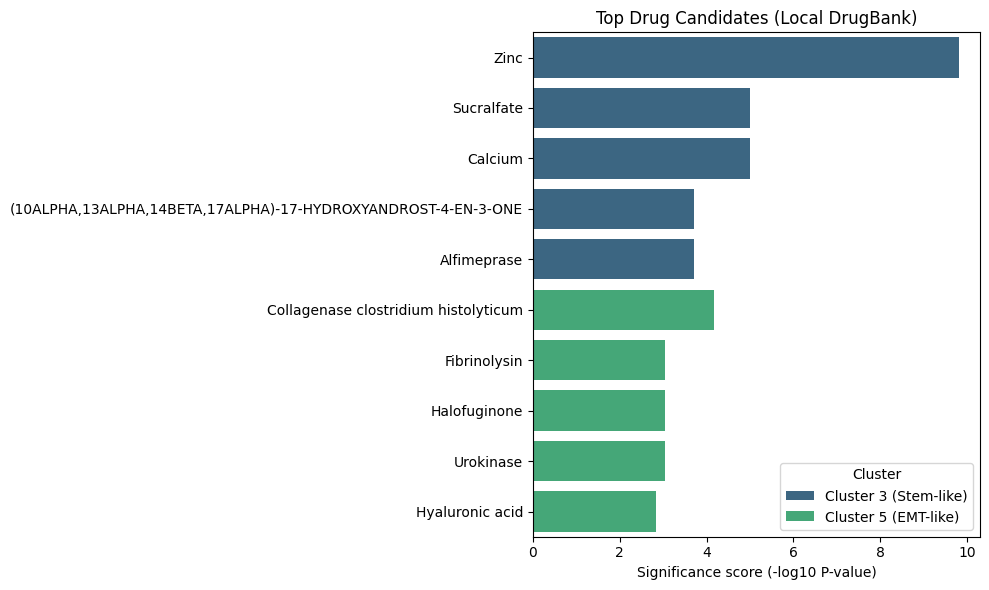

In [5]:
import pandas as pd
import gseapy as gp
import os
import matplotlib.pyplot as plt

# ==========================================
# 1. SETUP & FILE PATHS
# ==========================================
deg_file = '/Users/prabhasavvaru/Downloads/TNBC_Epithelial_Subcluster_DEGs_1.csv'
drugbank_file = '/Users/prabhasavvaru/Downloads/local_drugbank.csv'  # <--- The file you created from XML

print("--- Starting Local Drug Repurposing Analysis ---")

# Check if files exist
if not os.path.exists(deg_file):
    raise FileNotFoundError(f"❌ Error: {deg_file} not found. Please upload it.")
if not os.path.exists(drugbank_file):
    raise FileNotFoundError(f"❌ Error: {drugbank_file} not found. Please run the XML conversion code first.")

# ==========================================
# 2. PREPARE THE DATABASE
# ==========================================
print(f"Loading {drugbank_file}...")
db_df = pd.read_csv(drugbank_file)

# We need to convert the CSV into a Python Dictionary for GSEApy
# Format: {'Drug_Name': ['GeneA', 'GeneB', 'GeneC']}
print("Building Drug-Target Dictionary (this takes a moment)...")
drug_library = db_df.groupby('Drug')['Gene'].apply(list).to_dict()

print(f"✅ Library Ready: Contains {len(drug_library)} drugs.")

# ==========================================
# 3. DEFINE TARGET CLUSTERS
# ==========================================
# We want drugs that target genes in these specific clusters
target_clusters = {
    3: 'Cluster 3 (Stem-like)',
    5: 'Cluster 5 (EMT-like)'
}

# Load DEGs
deg_df = pd.read_csv(deg_file)

# Filter for Significant Genes (Adjusted P < 0.05, LogFold > 1.0)
sig_df = deg_df[(deg_df['pvals_adj'] < 0.01) & (deg_df['logfoldchanges'] > 1.0)]

# ==========================================
# 4. RUN ENRICHMENT (FIND DRUGS)
# ==========================================
results_list = []

for cluster_id, cluster_name in target_clusters.items():
    print(f"\n🔍 Analyzing {cluster_name}...")
    
    # Get the top 200 upregulated genes for this cluster
    gene_list = sig_df[sig_df['group'] == cluster_id] \
                .sort_values('logfoldchanges', ascending=False) \
                .head(200)['names'].tolist()
    
    if len(gene_list) < 5:
        print(f"   ⚠️ Not enough genes found for {cluster_name}. Skipping.")
        continue
        
    print(f"   Querying {len(gene_list)} genes against local DrugBank...")

    try:
        # Run Enrichment using the LOCAL dictionary
        enr = gp.enrich(
            gene_list=gene_list,
            gene_sets=drug_library,       # <--- Your Local Data
            background='hsapiens_gene_ensembl', # Standard human background
            outdir=None,
            verbose=False
        )
        
        # Process Results
        res = enr.results
        if res.empty:
            print("   -> No significant drug hits found.")
            continue
            
        # Filter by Adjusted P-value
        res = res[res['Adjusted P-value'] < 0.01].sort_values('Adjusted P-value')
        
        # Get Top 10 Candidates
        top_drugs = res.head(10)
        
        print(f"   ✅ Found {len(res)} potential drugs.")
        print(f"   -> Top Hit: {top_drugs.iloc[0]['Term']}")
        
        # Save to list
        for _, row in top_drugs.iterrows():
            results_list.append({
                'Cluster': cluster_name,
                'Drug': row['Term'],
                'P-value': row['Adjusted P-value'],
                'Overlap_Genes': row['Genes']
            })
            
    except Exception as e:
        print(f"   ❌ Error analyzing {cluster_name}: {e}")

# ==========================================
# 5. SAVE & SHOW RESULTS
# ==========================================
if results_list:
    final_df = pd.DataFrame(results_list)
    
    # Save to CSV
    output_filename = 'TNBC_Local_DrugBank_Repurposing_1.csv'
    final_df.to_csv(output_filename, index=False)
    
    print("\n" + "="*50)
    print("🏆 TOP DRUG CANDIDATES (Local Database)")
    print("="*50)
    print(final_df[['Cluster', 'Drug', 'P-value']].to_string(index=False))
    print(f"\n📄 Full results saved to: {output_filename}")
    
    # --- Visualization ---
    # Prepare data for plotting (Top 5 per cluster)
    plot_df = final_df.groupby('Cluster').head(5)
    plot_df['LogP'] = -np.log10(plot_df['P-value']) # Convert P-val to Score
    
    plt.figure(figsize=(10, 6))
    
    # Create Bar Plot
    import seaborn as sns
    sns.barplot(data=plot_df, y='Drug', x='LogP', hue='Cluster', palette='viridis')
    
    plt.title('Top Drug Candidates (Local DrugBank)')
    plt.xlabel('Significance score (-log10 P-value)')
    plt.ylabel('')
    plt.tight_layout()
    plt.show()

else:
    print("\n⚠️ No significant drug candidates found with the current thresholds.")